# Import Library

In [1]:
pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 395.9/395.9 kB 15.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 247.0/247.0 kB 22.5 MB/s eta 0:00:00


In [2]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=027698b551e7285548dd58e100d4b2a6e0c781b3b00146f08a456ba061cbe7f0
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from google.colab import drive
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from imblearn.under_sampling import TomekLinks, EditedNearestNeighbours
from imblearn.over_sampling import ADASYN, SMOTE
from imblearn.combine import SMOTEENN, SMOTETomek
from sklearn.feature_selection import mutual_info_classif
from scipy.stats import chi2_contingency
from sklearn.compose import ColumnTransformer
from collections import Counter
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
import lime
from lime.lime_tabular import LimeTabularExplainer
import optuna
import pickle

# Data Collection

In [4]:
# Mount Google Drive
drive.mount('/content/drive')

# Path folder
folder_path = '/content/drive/My Drive/SKRIPSI/report transaksi'

# List dan sort file CSV
files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]
files.sort()

# Membaca dan menyimpan ke dalam dictionary
dataframes = {}
for i, file in enumerate(files, start=1):
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)
    df['createdTime'] = pd.to_datetime(df['createdTime'], dayfirst=True)
    df = df.sort_values(by='createdTime', ascending=True).reset_index(drop=True)
    dataframes[f'trx{i}'] = df

trx1 = dataframes['trx13']
trx2 = dataframes['trx14']

Mounted at /content/drive


In [5]:
trx1

,id,createdTime,updatedTime,currency,amount,inquiryId,merchantId,type,paymentSource,status,statusCode,networkReferenceId,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
0,597c9c69-b786-4f48-8d41-0149e5fdaecb,2025-01-01 00:09:17,1/1/2025 00:09:17,IDR,1000,0e4d404c-6cda-4a61-98cd-2386241e6870,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authenticate,-1,NaN,NaN,1000,0,NaN,NaN
1,23ced33c-4d01-4945-8291-1ba41e3cf43b,2025-01-01 00:19:20,1/1/2025 00:19:22,IDR,458250,a7e2c819-755c-42ff-a41f-21975c09ea59,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,23ced33c4d01494582911ba41e3cf43b,458250.0,458250,0,0.0,NaN
2,ac6fce9a-90ca-4c94-9b87-e3f834e80b21,2025-01-01 00:20:05,1/1/2025 00:20:07,IDR,249000,999c76af-e471-4f7b-834d-844526d766df,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,ac6fce9a90ca4c949b87e3f834e80b21,249000.0,249000,0,0.0,NaN
3,7cc3ff52-df6d-4d27-b06c-8c27a2e892f5,2025-01-01 00:23:43,1/1/2025 00:24:15,IDR,0,d2664150-746f-4f4b-b9ff-402402d60fe5,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,7cc3ff52df6d4d27b06c8c27a2e892f5,NaN,1000,0,NaN,NaN
4,5a3fad2d-f8b4-435b-8e1f-9ca65e5ac313,2025-01-01 00:25:08,1/1/2025 00:25:09,IDR,1000,bf83a755-4352-46eb-97c2-bfd5d9be4801,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,declined,01,5a3fad2df8b4435b8e1f9ca65e5ac313,NaN,1000,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49769,b1adb00f-f324-4960-b31e-2a7c72ccbb19,2025-01-31 23:46:46,31/1/2025 23:47:14,IDR,0,7374b38b-c062-46f5-8162-304296b830ce,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,b1adb00ff3244960b31e2a7c72ccbb19,NaN,1000,0,NaN,NaN
49770,98c86898-c5b1-43dd-9cbe-08233f65fbc0,2025-01-31 23:49:10,31/1/2025 23:49:14,IDR,300000,e65e9cd3-d1c0-4e28-bf78-6e8f099e6557,ca66b877-a02b-466e-aa97-95632cb1877e,payment,bricard,captured,00,98c86898c5b143dd9cbe08233f65fbc0,298350.0,300000,0,1650.0,NaN
49771,c4dd6f7f-39f1-47d4-be5b-77a9e154efea,2025-01-31 23:53:41,31/1/2025 23:53:44,IDR,200000,c014ac8d-4ed5-4b58-9d05-5ce636770f49,ca66b877-a02b-466e-aa97-95632cb1877e,payment,bricard,captured,00,c4dd6f7f39f147d4be5b77a9e154efea,198900.0,200000,0,1100.0,NaN
49772,c0025a36-adc8-4f90-b596-4ca21e019cbd,2025-01-31 23:58:04,31/1/2025 23:58:07,IDR,266740,ddbfc0d4-4aa7-4dfd-9d0c-427a68c58e23,ca66b877-a02b-466e-aa97-95632cb1877e,payment,bricard,captured,00,c0025a36adc84f90b5964ca21e019cbd,265273.0,266740,0,1467.0,NaN


In [6]:
trx2

,id,createdTime,updatedTime,currency,amount,inquiryId,merchantId,type,paymentSource,status,statusCode,networkReferenceId,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
0,4e816d43-7666-45f0-90d7-ab82fb606818,2025-02-01 00:06:11,1/2/2025 00:06:14,IDR,62550,9e18757b-da87-403a-8dc4-32e313568775,ca66b877-a02b-466e-aa97-95632cb1877e,payment,bricard,captured,00,4e816d43766645f090d7ab82fb606818,62206.0,62550,0,344.0,NaN
1,01bb49a9-761e-4839-bf0e-94e14aef5807,2025-02-01 00:11:42,1/2/2025 00:11:45,IDR,250000,0f19ccbe-e8d9-42de-a971-417b921168d3,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,01bb49a9761e4839bf0e94e14aef5807,250000.0,250000,0,0.0,NaN
2,1dd3e89c-7d03-4eaa-a887-9a9d74241993,2025-02-01 00:13:05,1/2/2025 00:13:07,IDR,550000,07dce8a3-dbe4-4b8f-976e-2d77f4a1537f,ca66b877-a02b-466e-aa97-95632cb1877e,payment,bricard,captured,00,1dd3e89c7d034eaaa8879a9d74241993,546975.0,550000,0,3025.0,NaN
3,cdeec451-e297-4d22-aba3-04ce2679bbf6,2025-02-01 00:18:40,1/2/2025 00:18:43,IDR,294280,6b9e57dc-d610-4824-b616-e777fab0b76d,ca66b877-a02b-466e-aa97-95632cb1877e,payment,bricard,captured,00,cdeec451e2974d22aba304ce2679bbf6,292662.0,294280,0,1618.0,NaN
4,b7c77834-462d-469e-89ef-36da1b1a309f,2025-02-01 00:27:52,1/2/2025 00:27:55,IDR,150000,470a4d76-9c7a-4d30-b4fd-7d810c9ae749,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,b7c77834462d469e89ef36da1b1a309f,150000.0,150000,0,0.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46646,4936ce1c-a019-4a11-be9f-868c33c2ac11,2025-02-28 23:40:25,28/2/2025 23:40:28,IDR,300000,b7af2a87-8d01-4f88-831f-6a2f49c3d8e9,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,4936ce1ca0194a11be9f868c33c2ac11,300000.0,300000,0,0.0,NaN
46647,b38fe5aa-eb38-4286-9443-8aaf3df57125,2025-02-28 23:43:14,28/2/2025 23:43:17,IDR,350000,310b425b-1c47-456d-b46a-4c435a23fc63,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,b38fe5aaeb38428694438aaf3df57125,350000.0,350000,0,0.0,NaN
46648,7ed33318-3d08-4946-9427-50c74884b492,2025-02-28 23:47:08,28/2/2025 23:47:10,IDR,25000,33179918-4d88-4dc7-b9cb-fd9cfe1bede6,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,7ed333183d084946942750c74884b492,25000.0,25000,0,0.0,NaN
46649,b8d9f377-4614-4dfc-bb55-37dcb6093734,2025-02-28 23:51:35,28/2/2025 23:51:57,IDR,0,eb381c4a-1ba5-4cc4-97f7-40247394247c,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,b8d9f37746144dfcbb5537dcb6093734,NaN,1000,0,NaN,NaN


In [7]:
#Menggabungkan 2 dataframe
df = pd.concat([trx1, trx2], ignore_index=True)
df

,id,createdTime,updatedTime,currency,amount,inquiryId,merchantId,type,paymentSource,status,statusCode,networkReferenceId,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
0,597c9c69-b786-4f48-8d41-0149e5fdaecb,2025-01-01 00:09:17,1/1/2025 00:09:17,IDR,1000,0e4d404c-6cda-4a61-98cd-2386241e6870,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authenticate,-1,NaN,NaN,1000,0,NaN,NaN
1,23ced33c-4d01-4945-8291-1ba41e3cf43b,2025-01-01 00:19:20,1/1/2025 00:19:22,IDR,458250,a7e2c819-755c-42ff-a41f-21975c09ea59,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,23ced33c4d01494582911ba41e3cf43b,458250.0,458250,0,0.0,NaN
2,ac6fce9a-90ca-4c94-9b87-e3f834e80b21,2025-01-01 00:20:05,1/1/2025 00:20:07,IDR,249000,999c76af-e471-4f7b-834d-844526d766df,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,ac6fce9a90ca4c949b87e3f834e80b21,249000.0,249000,0,0.0,NaN
3,7cc3ff52-df6d-4d27-b06c-8c27a2e892f5,2025-01-01 00:23:43,1/1/2025 00:24:15,IDR,0,d2664150-746f-4f4b-b9ff-402402d60fe5,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,7cc3ff52df6d4d27b06c8c27a2e892f5,NaN,1000,0,NaN,NaN
4,5a3fad2d-f8b4-435b-8e1f-9ca65e5ac313,2025-01-01 00:25:08,1/1/2025 00:25:09,IDR,1000,bf83a755-4352-46eb-97c2-bfd5d9be4801,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,declined,01,5a3fad2df8b4435b8e1f9ca65e5ac313,NaN,1000,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96420,4936ce1c-a019-4a11-be9f-868c33c2ac11,2025-02-28 23:40:25,28/2/2025 23:40:28,IDR,300000,b7af2a87-8d01-4f88-831f-6a2f49c3d8e9,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,4936ce1ca0194a11be9f868c33c2ac11,300000.0,300000,0,0.0,NaN
96421,b38fe5aa-eb38-4286-9443-8aaf3df57125,2025-02-28 23:43:14,28/2/2025 23:43:17,IDR,350000,310b425b-1c47-456d-b46a-4c435a23fc63,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,b38fe5aaeb38428694438aaf3df57125,350000.0,350000,0,0.0,NaN
96422,7ed33318-3d08-4946-9427-50c74884b492,2025-02-28 23:47:08,28/2/2025 23:47:10,IDR,25000,33179918-4d88-4dc7-b9cb-fd9cfe1bede6,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,7ed333183d084946942750c74884b492,25000.0,25000,0,0.0,NaN
96423,b8d9f377-4614-4dfc-bb55-37dcb6093734,2025-02-28 23:51:35,28/2/2025 23:51:57,IDR,0,eb381c4a-1ba5-4cc4-97f7-40247394247c,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,b8d9f37746144dfcbb5537dcb6093734,NaN,1000,0,NaN,NaN


#Data Wrangling

### EDA

In [8]:
#Memeriksa dimensi data
df.shape

(96425, 17)

In [9]:
#Memeriksa informasi tipe data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96425 entries, 0 to 96424
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   id                  96425 non-null  object        
 1   createdTime         96425 non-null  datetime64[ns]
 2   updatedTime         96425 non-null  object        
 3   currency            96425 non-null  object        
 4   amount              96425 non-null  int64         
 5   inquiryId           96425 non-null  object        
 6   merchantId          96425 non-null  object        
 7   type                96425 non-null  object        
 8   paymentSource       96425 non-null  object        
 9   status              96425 non-null  object        
 10  statusCode          96425 non-null  object        
 11  networkReferenceId  90854 non-null  object        
 12  settlementAmount    75061 non-null  float64       
 13  inquiryAmount       96425 non-null  int64     

In [10]:
#Memeriksa jumlah data yang hilang
print("\nJumlah data yang hilang pada setiap kolom:")
print(df.isnull().sum())


Jumlah data yang hilang pada setiap kolom:
id                        0
createdTime               0
updatedTime               0
currency                  0
amount                    0
inquiryId                 0
merchantId                0
type                      0
paymentSource             0
status                    0
statusCode                0
networkReferenceId     5571
settlementAmount      21364
inquiryAmount             0
discountAmount            0
feeAmount             21366
Type Token            96292
dtype: int64


In [11]:
# Melihat nilai apa saja yang hilang dari beberapa baris
missing_values_trx = df[df.isnull().any(axis=1)]
missing_values_trx

,id,createdTime,updatedTime,currency,amount,inquiryId,merchantId,type,paymentSource,status,statusCode,networkReferenceId,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
0,597c9c69-b786-4f48-8d41-0149e5fdaecb,2025-01-01 00:09:17,1/1/2025 00:09:17,IDR,1000,0e4d404c-6cda-4a61-98cd-2386241e6870,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authenticate,-1,NaN,NaN,1000,0,NaN,NaN
1,23ced33c-4d01-4945-8291-1ba41e3cf43b,2025-01-01 00:19:20,1/1/2025 00:19:22,IDR,458250,a7e2c819-755c-42ff-a41f-21975c09ea59,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,23ced33c4d01494582911ba41e3cf43b,458250.0,458250,0,0.0,NaN
2,ac6fce9a-90ca-4c94-9b87-e3f834e80b21,2025-01-01 00:20:05,1/1/2025 00:20:07,IDR,249000,999c76af-e471-4f7b-834d-844526d766df,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,ac6fce9a90ca4c949b87e3f834e80b21,249000.0,249000,0,0.0,NaN
3,7cc3ff52-df6d-4d27-b06c-8c27a2e892f5,2025-01-01 00:23:43,1/1/2025 00:24:15,IDR,0,d2664150-746f-4f4b-b9ff-402402d60fe5,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,7cc3ff52df6d4d27b06c8c27a2e892f5,NaN,1000,0,NaN,NaN
4,5a3fad2d-f8b4-435b-8e1f-9ca65e5ac313,2025-01-01 00:25:08,1/1/2025 00:25:09,IDR,1000,bf83a755-4352-46eb-97c2-bfd5d9be4801,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,declined,01,5a3fad2df8b4435b8e1f9ca65e5ac313,NaN,1000,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96420,4936ce1c-a019-4a11-be9f-868c33c2ac11,2025-02-28 23:40:25,28/2/2025 23:40:28,IDR,300000,b7af2a87-8d01-4f88-831f-6a2f49c3d8e9,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,4936ce1ca0194a11be9f868c33c2ac11,300000.0,300000,0,0.0,NaN
96421,b38fe5aa-eb38-4286-9443-8aaf3df57125,2025-02-28 23:43:14,28/2/2025 23:43:17,IDR,350000,310b425b-1c47-456d-b46a-4c435a23fc63,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,b38fe5aaeb38428694438aaf3df57125,350000.0,350000,0,0.0,NaN
96422,7ed33318-3d08-4946-9427-50c74884b492,2025-02-28 23:47:08,28/2/2025 23:47:10,IDR,25000,33179918-4d88-4dc7-b9cb-fd9cfe1bede6,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,captured,00,7ed333183d084946942750c74884b492,25000.0,25000,0,0.0,NaN
96423,b8d9f377-4614-4dfc-bb55-37dcb6093734,2025-02-28 23:51:35,28/2/2025 23:51:57,IDR,0,eb381c4a-1ba5-4cc4-97f7-40247394247c,e8783a98-ec6a-45b8-acf6-4f856010d9ee,payment,bricard,authorized,00,b8d9f37746144dfcbb5537dcb6093734,NaN,1000,0,NaN,NaN


In [12]:
#mengganti nilai pada kolom paymentsource
#def mask_payment_source(df):
    #unique_sources = df['paymentSource'].unique()
    #mapping = {source: f"Pay{i+1}" for i, source in enumerate(unique_sources)}
    #df['paymentSource'] = df['paymentSource'].map(mapping)
    #return df

#df = mask_payment_source(df)
#df.head()


In [13]:
# Create a mapping for unique merchant IDs
unique_merchants = df['merchantId'].unique()
merchant_mapping = {merchant: f"merch{i+1}" for i, merchant in enumerate(unique_merchants)}

# Replace merchant IDs with the new labels
df['merchantId'] = df['merchantId'].map(merchant_mapping)
df.head()

,id,createdTime,updatedTime,currency,amount,inquiryId,merchantId,type,paymentSource,status,statusCode,networkReferenceId,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
0,597c9c69-b786-4f48-8d41-0149e5fdaecb,2025-01-01 00:09:17,1/1/2025 00:09:17,IDR,1000,0e4d404c-6cda-4a61-98cd-2386241e6870,merch1,payment,bricard,authenticate,-1,NaN,NaN,1000,0,NaN,NaN
1,23ced33c-4d01-4945-8291-1ba41e3cf43b,2025-01-01 00:19:20,1/1/2025 00:19:22,IDR,458250,a7e2c819-755c-42ff-a41f-21975c09ea59,merch1,payment,bricard,captured,00,23ced33c4d01494582911ba41e3cf43b,458250.0,458250,0,0.0,NaN
2,ac6fce9a-90ca-4c94-9b87-e3f834e80b21,2025-01-01 00:20:05,1/1/2025 00:20:07,IDR,249000,999c76af-e471-4f7b-834d-844526d766df,merch1,payment,bricard,captured,00,ac6fce9a90ca4c949b87e3f834e80b21,249000.0,249000,0,0.0,NaN
3,7cc3ff52-df6d-4d27-b06c-8c27a2e892f5,2025-01-01 00:23:43,1/1/2025 00:24:15,IDR,0,d2664150-746f-4f4b-b9ff-402402d60fe5,merch1,payment,bricard,authorized,00,7cc3ff52df6d4d27b06c8c27a2e892f5,NaN,1000,0,NaN,NaN
4,5a3fad2d-f8b4-435b-8e1f-9ca65e5ac313,2025-01-01 00:25:08,1/1/2025 00:25:09,IDR,1000,bf83a755-4352-46eb-97c2-bfd5d9be4801,merch1,payment,bricard,declined,01,5a3fad2df8b4435b8e1f9ca65e5ac313,NaN,1000,0,NaN,NaN


In [14]:
# Melihat nilai unique yang ada pada data
for column in df.columns:
    unique_values = df[column].unique()
    print(f"Unique values in column '{column}':")
    print(unique_values)
    print("-" * 20)

Unique values in column 'id':
['597c9c69-b786-4f48-8d41-0149e5fdaecb'
 '23ced33c-4d01-4945-8291-1ba41e3cf43b'
 'ac6fce9a-90ca-4c94-9b87-e3f834e80b21' ...
 '7ed33318-3d08-4946-9427-50c74884b492'
 'b8d9f377-4614-4dfc-bb55-37dcb6093734'
 'c2c3c483-0f28-42b6-8cb1-f24f54350d5d']
--------------------
Unique values in column 'createdTime':
<DatetimeArray>
['2025-01-01 00:09:17', '2025-01-01 00:19:20', '2025-01-01 00:20:05',
 '2025-01-01 00:23:43', '2025-01-01 00:25:08', '2025-01-01 00:26:39',
 '2025-01-01 00:28:16', '2025-01-01 00:28:26', '2025-01-01 00:33:51',
 '2025-01-01 00:40:31',
 ...
 '2025-02-28 23:27:08', '2025-02-28 23:29:12', '2025-02-28 23:30:59',
 '2025-02-28 23:32:49', '2025-02-28 23:35:28', '2025-02-28 23:40:25',
 '2025-02-28 23:43:14', '2025-02-28 23:47:08', '2025-02-28 23:51:35',
 '2025-02-28 23:59:30']
Length: 95138, dtype: datetime64[ns]
--------------------
Unique values in column 'updatedTime':
['1/1/2025 00:09:17' '1/1/2025 00:19:22' '1/1/2025 00:20:07' ...
 '28/2/2025 23

In [15]:
# prompt: melihat 50 baris 'static' di Type Token

df_static = df[df['Type Token'] == 'static']
df_static.head(50)

,id,createdTime,updatedTime,currency,amount,inquiryId,merchantId,type,paymentSource,status,statusCode,networkReferenceId,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
217,fdd63fc1-cf4e-45d1-a3aa-cef969aa822b,2025-01-01 09:42:17,1/1/2025 09:42:17,IDR,11230,0a16109a-8755-42a4-af39-4261dc4ac030,merch4,payment,indodana,declined,ERROR,NaN,NaN,11230,0,NaN,static
242,fb7523ee-061e-4af5-815c-8ed2cc3cd1de,2025-01-01 10:03:17,1/1/2025 10:08:51,IDR,11230,0a16109a-8755-42a4-af39-4261dc4ac030,merch4,payment,dana,failed,05,20250101111212800110166133832205728,NaN,11230,0,NaN,static
283,21f89e81-07bc-429c-abda-9d4e4b75afec,2025-01-01 10:36:58,1/1/2025 10:42:53,IDR,31938,0d44bdec-77be-458c-9dd8-f261aa9f38c1,merch4,payment,dana,failed,05,20250101111212800110166399232103676,NaN,31938,0,NaN,static
11952,10222620-f250-45e9-94eb-17fcd5da35ca,2025-01-09 01:41:49,9/1/2025 01:42:52,IDR,1000,a2700b2f-e2f2-4710-a2d8-a901bfb6457f,merch4,payment,mtiiso,declined,51,500901343023,NaN,1000,0,NaN,static
11953,2446a814-9e91-4424-8c0e-9afb9513d102,2025-01-09 01:44:57,9/1/2025 01:46:02,IDR,1000,66955b38-04fd-4e49-bc13-dce8bf30b338,merch4,payment,mtiiso,declined,57,500901343539,NaN,1000,0,NaN,static
11956,605efff7-c46f-48dd-8133-73a5307a608f,2025-01-09 01:53:28,9/1/2025 01:54:53,IDR,1001,be5813c3-487e-4e41-b78c-b0c93e237824,merch4,payment,mtiiso,captured,00,500901345034,NaN,1001,0,NaN,static
18882,336c011b-872c-4ac0-8716-2dee10ff8683,2025-01-13 11:17:25,13/1/2025 11:17:25,IDR,1001,be5813c3-487e-4e41-b78c-b0c93e237824,merch4,refund,mtiiso,declined,AL,501311039988,NaN,1001,0,NaN,static
18883,174c6de0-a72c-4612-a922-2ac122734893,2025-01-13 11:19:59,13/1/2025 11:19:59,IDR,1001,be5813c3-487e-4e41-b78c-b0c93e237824,merch4,refund,mtiiso,declined,AL,501311044372,NaN,1001,0,NaN,static
19115,25c2f4f1-f8d9-435b-a8b2-f165cbc360ee,2025-01-13 14:09:40,13/1/2025 14:10:42,IDR,100,1f658da5-b87d-46bb-be27-7361814dc065,merch4,payment,mtiiso,declined,57,501314364585,NaN,100,0,NaN,static
19124,3f7d3788-00d9-4ba6-a955-0ad70918fbc6,2025-01-13 14:19:45,13/1/2025 14:20:24,IDR,100,33b57f60-c057-4c68-9f62-ea173eab79f9,merch4,payment,mtiiso,captured,00,501314387135,NaN,100,0,NaN,static


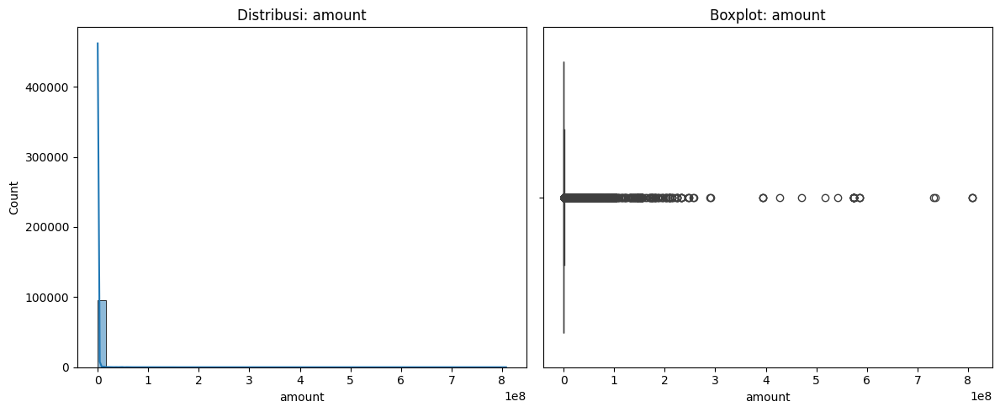

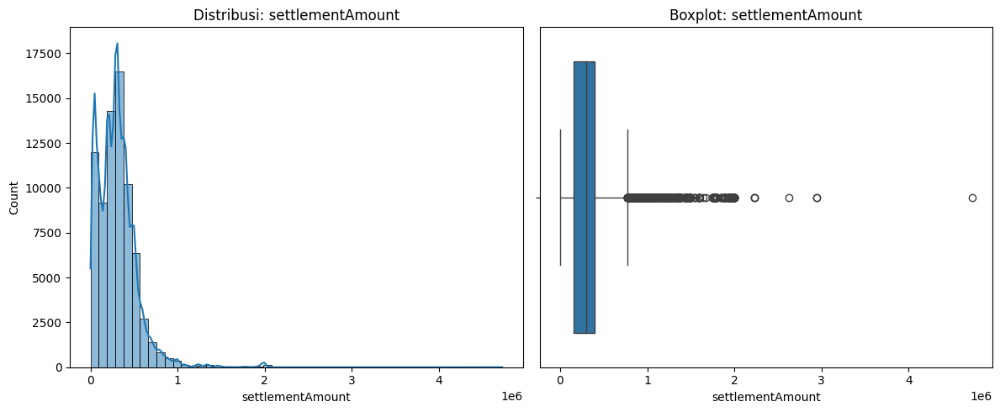

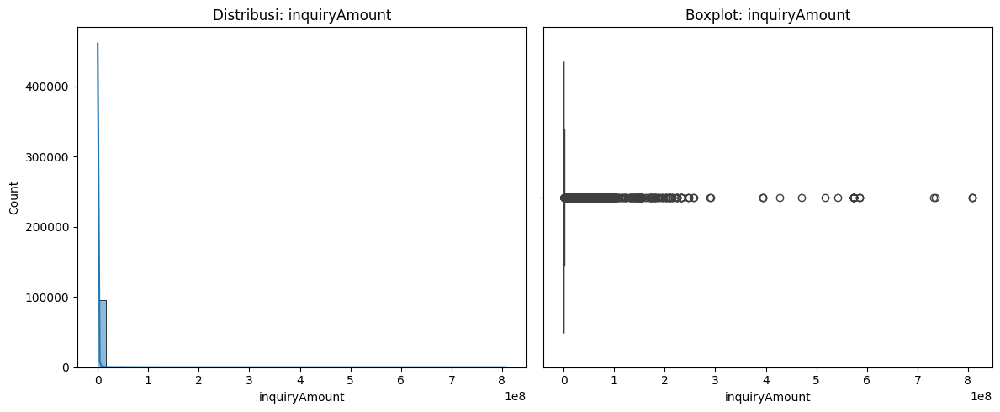

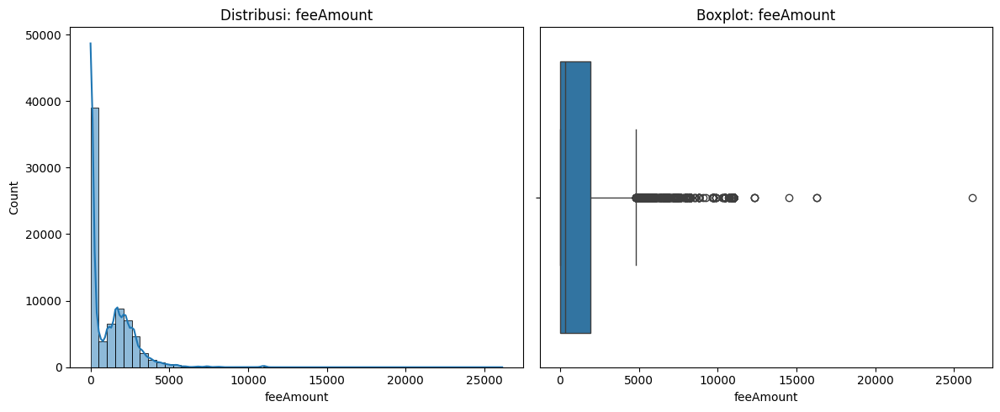

In [16]:
#Visualiasasi distribusi fitur numerik
num_cols = ['amount', 'settlementAmount', 'inquiryAmount', 'feeAmount']

# Plot distribusi
for col in num_cols:
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.histplot(df[col], bins=50, kde=True)
    plt.title(f'Distribusi: {col}')

    plt.subplot(1, 2, 2)
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot: {col}')

    plt.tight_layout()
    plt.show()


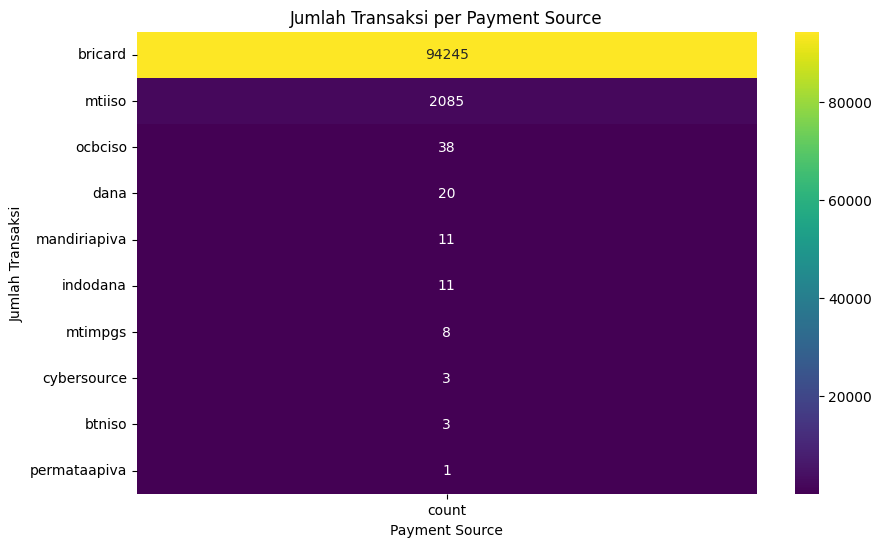

In [17]:
# Visualisasi fitur kategorikal paymentSource
plt.figure(figsize=(10, 6))
payment_source_counts = df['paymentSource'].value_counts()
sns.heatmap(payment_source_counts.to_frame(), annot=True, fmt='d', cmap='viridis')
plt.title('Jumlah Transaksi per Payment Source')
plt.xlabel('Payment Source')
plt.ylabel('Jumlah Transaksi')
plt.show()

/tmp/ipython-input-18-314201341.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='status', data=df, palette='viridis')


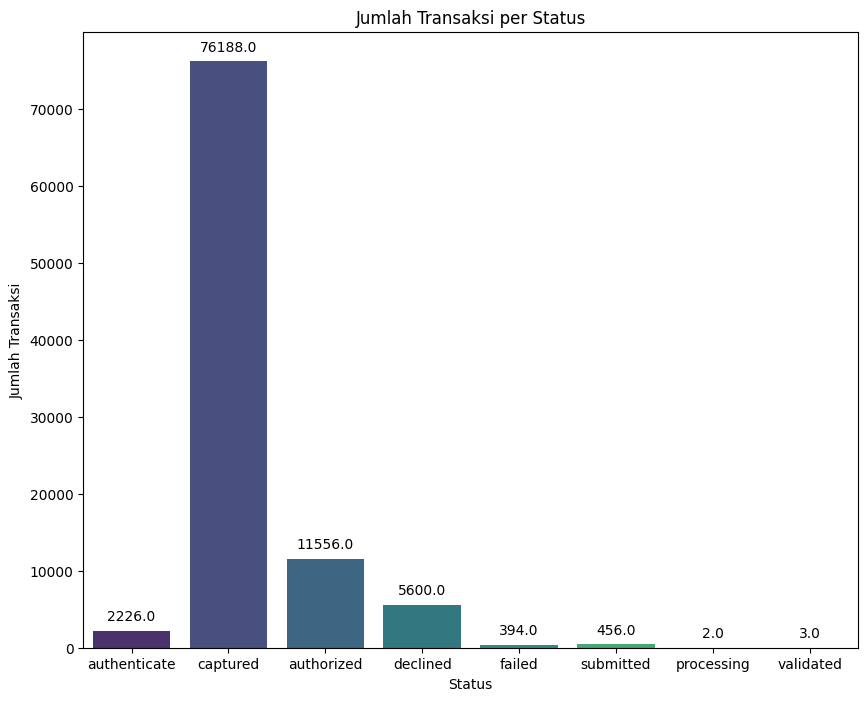

In [18]:
#Visualisasi distribusi fitur kategorik Status
plt.figure(figsize=(10, 8))
status_counts = df['status'].value_counts()
sns.countplot(x='status', data=df, palette='viridis')
plt.title('Jumlah Transaksi per Status')
plt.xlabel('Status')
plt.ylabel('Jumlah Transaksi')

# Add count annotations on top of each bar
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.show()


/tmp/ipython-input-19-3576518629.py:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='type', data=df, palette='viridis')  # Use a different color palette


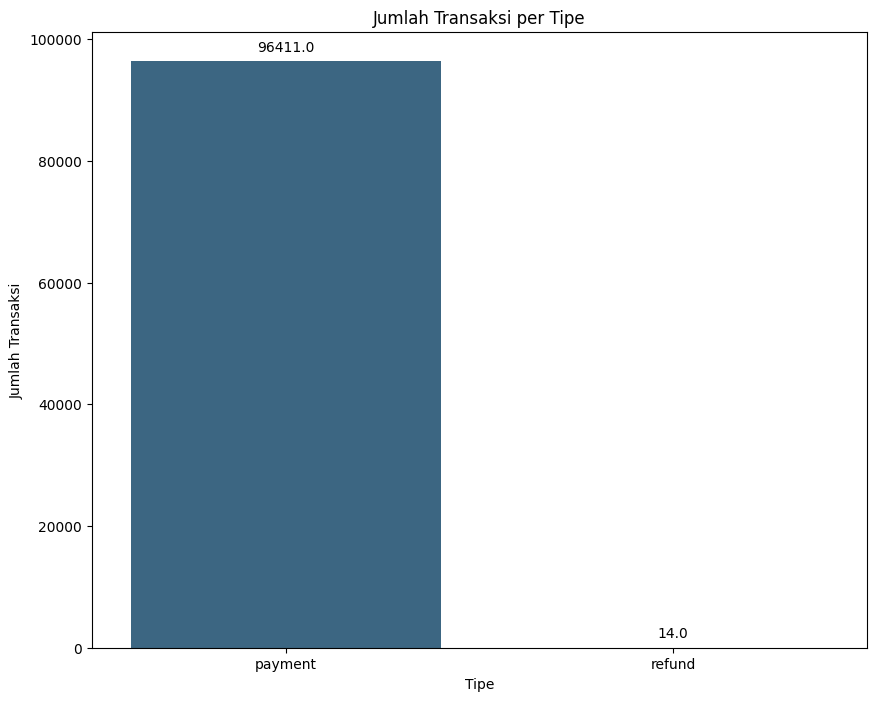

In [19]:
# Visualisasi distribusi fitur kategorik Type
plt.figure(figsize=(10, 8))
type_counts = df['type'].value_counts()
sns.countplot(x='type', data=df, palette='viridis')  # Use a different color palette
plt.title('Jumlah Transaksi per Tipe')
plt.xlabel('Tipe')
plt.ylabel('Jumlah Transaksi')

# Add count annotations on top of each bar
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                   ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.show()


/tmp/ipython-input-20-1564330672.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Type Token', data=df, palette='viridis')


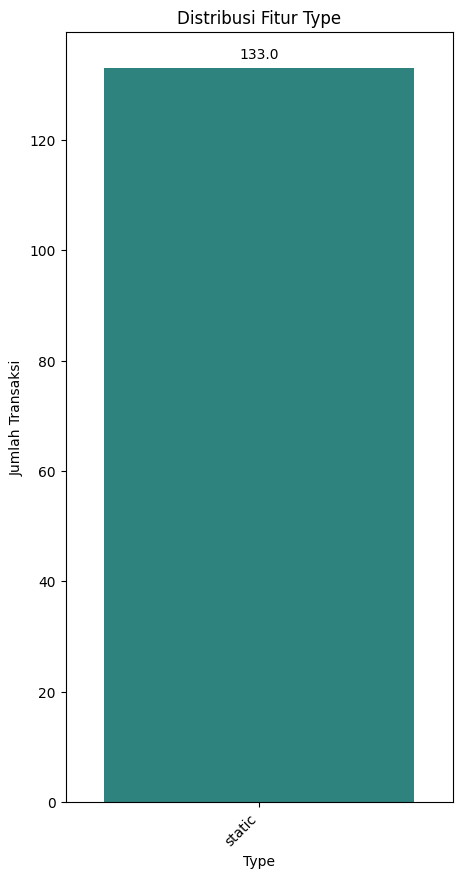

In [20]:
# visualisasi distribusi fitur Type Token
plt.figure(figsize=(5, 10))
sns.countplot(x='Type Token', data=df, palette='viridis')
plt.title('Distribusi Fitur Type')
plt.xlabel('Type')
plt.ylabel('Jumlah Transaksi')
plt.xticks(rotation=45, ha='right')
# Menambahkan anotasi jumlah pada setiap bar
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.show()

### Data Preprocessing

In [21]:
# Drop the specified columns
columns_to_drop = ['id','inquiryId','networkReferenceId']
df = df.drop(columns=columns_to_drop, errors='ignore')

#### Handling Missing Value

In [22]:
# Check for missing values in 'settlementAmount'
missing_settlement_amount = df[df['settlementAmount'].isnull()]
missing_settlement_amount

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token
0,2025-01-01 00:09:17,1/1/2025 00:09:17,IDR,1000,merch1,payment,bricard,authenticate,-1,NaN,1000,0,NaN,NaN
3,2025-01-01 00:23:43,1/1/2025 00:24:15,IDR,0,merch1,payment,bricard,authorized,00,NaN,1000,0,NaN,NaN
4,2025-01-01 00:25:08,1/1/2025 00:25:09,IDR,1000,merch1,payment,bricard,declined,01,NaN,1000,0,NaN,NaN
6,2025-01-01 00:28:16,1/1/2025 00:28:45,IDR,0,merch1,payment,bricard,authorized,00,NaN,1000,0,NaN,NaN
9,2025-01-01 00:40:31,1/1/2025 00:41:20,IDR,0,merch1,payment,bricard,authorized,00,NaN,1000,0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96413,2025-02-28 23:21:19,28/2/2025 23:21:56,IDR,1000,merch1,payment,bricard,declined,01,NaN,1000,0,NaN,NaN
96414,2025-02-28 23:24:20,28/2/2025 23:25:03,IDR,0,merch1,payment,bricard,authorized,00,NaN,1000,0,NaN,NaN
96416,2025-02-28 23:29:12,28/2/2025 23:31:50,IDR,0,merch1,payment,bricard,authorized,00,NaN,1000,0,NaN,NaN
96418,2025-02-28 23:32:49,28/2/2025 23:33:54,IDR,0,merch1,payment,bricard,authorized,00,NaN,1000,0,NaN,NaN


Penanganan missing value pada settlement amount dan fee amount

In [23]:
#Penanganan missing value pada kolom Settlement amount dan fee amount
df['settlementAmount'].fillna(0, inplace=True)
df['feeAmount'].fillna(0, inplace=True)

/tmp/ipython-input-23-896129649.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['settlementAmount'].fillna(0, inplace=True)
/tmp/ipython-input-23-896129649.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try 

In [24]:
df.isnull().sum()

,0
createdTime,0
updatedTime,0
currency,0
amount,0
merchantId,0
type,0
paymentSource,0
status,0
statusCode,0
settlementAmount,0


sudah tidak ada missing value lagi

#### Mengubah tipe data

In [25]:
# Convert to datetime
df['updatedTime'] = pd.to_datetime(df['updatedTime'], dayfirst=True, format='mixed')
df['createdTime'] = pd.to_datetime(df['createdTime'])

# Convert to float
df['amount'] = df['amount'].astype(float)
df['settlementAmount'] = df['settlementAmount'].astype(float)
df['feeAmount'] = df['feeAmount'].astype(float)
df['discountAmount'] = df['discountAmount'].astype(float)
df['inquiryAmount'] = df['inquiryAmount'].astype(float)

# Convert categorical fields
categorical_cols = ['merchantId','paymentSource', 'status','statusCode']
for col in categorical_cols:
    df[col] = df[col].astype('category')

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96425 entries, 0 to 96424
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   createdTime       96425 non-null  datetime64[ns]
 1   updatedTime       96425 non-null  datetime64[ns]
 2   currency          96425 non-null  object        
 3   amount            96425 non-null  float64       
 4   merchantId        96425 non-null  category      
 5   type              96425 non-null  object        
 6   paymentSource     96425 non-null  category      
 7   status            96425 non-null  category      
 8   statusCode        96425 non-null  category      
 9   settlementAmount  96425 non-null  float64       
 10  inquiryAmount     96425 non-null  float64       
 11  discountAmount    96425 non-null  float64       
 12  feeAmount         96425 non-null  float64       
 13  Type Token        133 non-null    object        
dtypes: category(4), dateti

#### Feature Engineering

Feature Creation

In [27]:
#Menghitung frekuensi transaksi harian setiap merchant
df['createdDate'] = pd.to_datetime(df['createdTime']).dt.date
frekuensi_harian = df.groupby(['merchantId', 'createdDate']).size().reset_index(name='daily_freq')
df = df.merge(frekuensi_harian, on=['merchantId', 'createdDate'])

#Menghitung jumlah transaksi gagal harian setiap merchant
df['is_declined'] = df['status'].str.lower() == 'declined'
failed_per_day = df.groupby(['merchantId', 'createdDate'])['is_declined'].sum().reset_index(name='failed_count')
df = df.merge(failed_per_day, on=['merchantId', 'createdDate'])

#Memeriksa nominal transaksi tinggi pada setiap merchant
df['is_nominal_tinggi'] = df['amount'] > 8_000_000

#Memeriksa kecocokan nominal pada inquiry amount dan settlement amount
df['mismatch'] = abs(df['inquiryAmount'] - df['settlementAmount'])

/tmp/ipython-input-27-201044474.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  frekuensi_harian = df.groupby(['merchantId', 'createdDate']).size().reset_index(name='daily_freq')
/tmp/ipython-input-27-201044474.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  failed_per_day = df.groupby(['merchantId', 'createdDate'])['is_declined'].sum().reset_index(name='failed_count')


In [28]:
#Menghitung rata-rata transaksi gagal harian setiap merchant
avg_failed_per_merchant = failed_per_day.groupby('merchantId')['failed_count'].mean().reset_index(name='avg_failed')
df = df.merge(avg_failed_per_merchant, on='merchantId', how='left')

#Menghitung rasio gagal terhadap total transaksi harian setiap merchant
df['fail_ratio'] = df['failed_count'] / df['daily_freq']

# Filter hanya transaksi gagal
failed_trx = df[df['is_declined']].copy()
failed_trx['createdTime'] = pd.to_datetime(failed_trx['createdTime'])

# Urutkan transaksi gagal per merchant dan hitung selisih waktu
failed_trx = failed_trx.sort_values(by=['merchantId', 'createdTime'])
failed_trx['prev_failed_time'] = failed_trx.groupby('merchantId')['createdTime'].shift(1)
failed_trx['failed_time_diff'] = (failed_trx['createdTime'] - failed_trx['prev_failed_time']).dt.total_seconds()

# Hitung rata-rata selisih waktu antar transaksi gagal per hari per merchant
failed_trx['createdDate'] = failed_trx['createdTime'].dt.date
failed_diff_daily = failed_trx.groupby(['merchantId', 'createdDate'])['failed_time_diff'].mean().reset_index(name='avg_fail_interval')

# Hitung jumlah transaksi gagal per hari per merchant (untuk cek hanya 1 trx atau tidak)
failed_count_per_day = failed_trx.groupby(['merchantId', 'createdDate']).size().reset_index(name='count_failed')

# Gabungkan informasi jumlah transaksi gagal ke dalam failed_diff_daily
failed_diff_daily = failed_diff_daily.merge(failed_count_per_day, on=['merchantId', 'createdDate'])

# Jika hanya ada 1 transaksi gagal, isi avg_fail_interval = 0 (tidak bisa hitung interval)
failed_diff_daily['avg_fail_interval'] = np.where(
    failed_diff_daily['count_failed'] < 2,
    0,
    failed_diff_daily['avg_fail_interval']
)

# Gabungkan ke df berdasarkan merchantId dan createdDate
df = df.merge(
    failed_diff_daily[['merchantId', 'createdDate', 'avg_fail_interval']],
    on=['merchantId', 'createdDate'],
    how='left'
)

# Isi NaN dengan 0 jika tidak ditemukan (misalnya tidak ada transaksi gagal di hari itu)
df['avg_fail_interval'] = df['avg_fail_interval'].fillna(0)

#Menghitung rasio selisih inquiry amount dan settlement amount
df['mismatch_ratio'] = np.where(
    df['inquiryAmount'] == 0,
    0,  # atau bisa juga np.nan tergantung logika bisnis kamu
    abs(df['settlementAmount'] - df['inquiryAmount']) / df['inquiryAmount']
)

/tmp/ipython-input-28-177508262.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  avg_failed_per_merchant = failed_per_day.groupby('merchantId')['failed_count'].mean().reset_index(name='avg_failed')
/tmp/ipython-input-28-177508262.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  failed_trx['prev_failed_time'] = failed_trx.groupby('merchantId')['createdTime'].shift(1)
/tmp/ipython-input-28-177508262.py:19: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future

In [29]:
df

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,...,createdDate,daily_freq,is_declined,failed_count,is_nominal_tinggi,mismatch,avg_failed,fail_ratio,avg_fail_interval,mismatch_ratio
0,2025-01-01 00:09:17,2025-01-01 00:09:17,IDR,1000.0,merch1,payment,bricard,authenticate,-1,0.0,...,2025-01-01,963,False,69,False,1000.0,64.186441,0.071651,1203.088235,1.000000
1,2025-01-01 00:19:20,2025-01-01 00:19:22,IDR,458250.0,merch1,payment,bricard,captured,00,458250.0,...,2025-01-01,963,False,69,False,0.0,64.186441,0.071651,1203.088235,0.000000
2,2025-01-01 00:20:05,2025-01-01 00:20:07,IDR,249000.0,merch1,payment,bricard,captured,00,249000.0,...,2025-01-01,963,False,69,False,0.0,64.186441,0.071651,1203.088235,0.000000
3,2025-01-01 00:23:43,2025-01-01 00:24:15,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,...,2025-01-01,963,False,69,False,1000.0,64.186441,0.071651,1203.088235,1.000000
4,2025-01-01 00:25:08,2025-01-01 00:25:09,IDR,1000.0,merch1,payment,bricard,declined,01,0.0,...,2025-01-01,963,True,69,False,1000.0,64.186441,0.071651,1203.088235,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96420,2025-02-28 23:40:25,2025-02-28 23:40:28,IDR,300000.0,merch1,payment,bricard,captured,00,300000.0,...,2025-02-28,722,False,66,False,0.0,64.186441,0.091413,1281.075758,0.000000
96421,2025-02-28 23:43:14,2025-02-28 23:43:17,IDR,350000.0,merch1,payment,bricard,captured,00,350000.0,...,2025-02-28,722,False,66,False,0.0,64.186441,0.091413,1281.075758,0.000000
96422,2025-02-28 23:47:08,2025-02-28 23:47:10,IDR,25000.0,merch1,payment,bricard,captured,00,25000.0,...,2025-02-28,722,False,66,False,0.0,64.186441,0.091413,1281.075758,0.000000
96423,2025-02-28 23:51:35,2025-02-28 23:51:57,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,...,2025-02-28,722,False,66,False,1000.0,64.186441,0.091413,1281.075758,1.000000


#### Rule-Based PreLabelling

In [30]:
#Statistika Deskriptif
df.describe(include='all')

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,...,createdDate,daily_freq,is_declined,failed_count,is_nominal_tinggi,mismatch,avg_failed,fail_ratio,avg_fail_interval,mismatch_ratio
count,96425,96425,96425,9.642500e+04,96425,96425,96425,96425,96425,9.642500e+04,...,96425,96425.000000,96425,96425.000000,96425,9.642500e+04,96425.000000,96425.000000,9.642500e+04,96425.000000
unique,NaN,NaN,1,NaN,36,2,10,8,42,NaN,...,59,NaN,2,NaN,2,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,IDR,NaN,merch1,payment,bricard,captured,00,NaN,...,2025-01-25,NaN,False,NaN,False,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,96425,NaN,48281,96411,94245,76188,87743,NaN,...,2233,NaN,90825,NaN,95366,NaN,NaN,NaN,NaN,NaN
mean,2025-01-30 22:44:46.383105792,2025-01-30 22:46:39.570204928,NaN,1.003407e+06,NaN,NaN,NaN,NaN,NaN,2.374480e+05,...,NaN,816.835520,NaN,41.975847,NaN,7.730482e+05,42.170985,0.058076,3.916583e+03,0.224018
min,2025-01-01 00:09:17,2025-01-01 00:09:17,NaN,0.000000e+00,NaN,NaN,NaN,NaN,NaN,0.000000e+00,...,NaN,1.000000,NaN,0.000000,NaN,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000
25%,2025-01-17 00:55:20,2025-01-17 00:55:55,NaN,4.000000e+04,NaN,NaN,NaN,NaN,NaN,2.983500e+04,...,NaN,713.000000,NaN,20.000000,NaN,0.000000e+00,20.881356,0.021689,1.319381e+03,0.000000
50%,2025-01-31 08:35:59,2025-01-31 08:36:24,NaN,2.388200e+05,NaN,NaN,NaN,NaN,NaN,2.000000e+05,...,NaN,834.000000,NaN,38.000000,NaN,1.000000e+03,64.186441,0.053097,2.139294e+03,0.005499
75%,2025-02-14 10:41:50,2025-02-14 10:41:54,NaN,3.907000e+05,NaN,NaN,NaN,NaN,NaN,3.679650e+05,...,NaN,961.000000,NaN,65.000000,NaN,1.815000e+03,64.186441,0.082982,4.562647e+03,0.005500
max,2025-02-28 23:59:30,2025-02-28 23:59:33,NaN,8.080107e+08,NaN,NaN,NaN,NaN,NaN,4.725864e+06,...,NaN,1224.000000,NaN,104.000000,NaN,8.080107e+08,64.186441,1.000000,1.477102e+06,1.000000


In [31]:
thresholds = {
    'daily_freq': df['daily_freq'].quantile(0.95),
    'amount': df['amount'].quantile(0.95),
    'failed_count': df['failed_count'].quantile(0.95),
    'mismatch': df['mismatch'].quantile(0.95)
}

def detect_anomaly1(row, thresholds):
    if row['daily_freq'] > thresholds['daily_freq']:
        if row['amount'] > thresholds['amount']:
            if row['failed_count'] > thresholds['failed_count']:
                if row['mismatch'] > thresholds['mismatch']:
                    return 'Fraud'  # Semua indikator terpenuhi
                else:
                    return 'Fraud'  # 3 indikator terpenuhi
            else:
                if row['mismatch'] > thresholds['mismatch']:
                  if row['mismatch_ratio'] < 0.01 and row ['failed_count'] == 0:
                    return 'Not Fraud'
                  else:
                    return 'Fraud'
                else:
                    return 'Not Fraud'
        else:
            if row['failed_count'] > thresholds['failed_count'] and row['mismatch'] > thresholds['mismatch']:
                return 'Fraud'
            else:
                return 'Not Fraud'
    else:
        # FREKUENSI <= threshold
        if row['amount'] > thresholds['amount']:
            if row['failed_count'] > thresholds['failed_count'] or row['mismatch'] > thresholds['mismatch']:
                return 'Fraud'
            else:
                return 'Not Fraud'
        else:
            return 'Not Fraud'

def detect_anomaly2(row):
    if row['failed_count'] > 2 * row['avg_failed']:  # Tingkat gagal lebih dari 2x lipat rata-rata
        if row['fail_ratio'] > 0.7:  # Lebih dari 30% transaksi adalah gagal
            if row['avg_fail_interval'] < 60:  # Transaksi gagal terlalu cepat (misal < 60 detik)
                return 'Fraud'
            else:
                return 'Fraud'
        else:
            if row['avg_fail_interval'] < 60:
                return 'Fraud'
            else:
                return 'Not Fraud'
    else:
        if row['fail_ratio'] > 0.4:
            return 'Fraud'
        else:
            return 'Not Fraud'

def detect_anomaly3(row): #Mendeteksi transaksi dengan mismatch ratio > 1.0 (lonjakan 100%)
    if row['mismatch_ratio'] > 1.0:
        return 'Fraud'
    else:
        return 'Not Fraud'


In [32]:
def detect_combined_anomaly(row, thresholds):
    result1 = detect_anomaly1(row, thresholds)
    result2 = detect_anomaly2(row)
    result3 = detect_anomaly3(row)

    if 'Fraud' in [result1, result2, result3]:
        return 'Fraud'
    else:
        return 'Not Fraud'

In [33]:
df['label1'] = df.apply(lambda row: detect_anomaly1(row, thresholds), axis=1)
df['label2'] = df.apply(detect_anomaly2, axis=1)
df['label3'] = df.apply(detect_anomaly3, axis=1)
df['fraud'] = df.apply(lambda row: detect_combined_anomaly(row, thresholds), axis=1)

In [34]:
df[['label1', 'label2', 'label3', 'fraud']].apply(pd.Series.value_counts)

,label1,label2,label3,fraud
Fraud,2909,415,NaN,3061
Not Fraud,93516,96010,96425.0,93364


In [35]:
# Drop specified columns
columns_to_drop = ['createdDate', 'daily_freq', 'is_declined', 'failed_count', 'is_nominal_tinggi', 'mismatch', 'avg_failed', 'fail_ratio', 'avg_fail_interval', 'mismatch_ratio', 'label1',	'label2',	'label3']
df = df.drop(columns=columns_to_drop, errors='ignore')

df

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token,fraud
0,2025-01-01 00:09:17,2025-01-01 00:09:17,IDR,1000.0,merch1,payment,bricard,authenticate,-1,0.0,1000.0,0.0,0.0,NaN,Not Fraud
1,2025-01-01 00:19:20,2025-01-01 00:19:22,IDR,458250.0,merch1,payment,bricard,captured,00,458250.0,458250.0,0.0,0.0,NaN,Not Fraud
2,2025-01-01 00:20:05,2025-01-01 00:20:07,IDR,249000.0,merch1,payment,bricard,captured,00,249000.0,249000.0,0.0,0.0,NaN,Not Fraud
3,2025-01-01 00:23:43,2025-01-01 00:24:15,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,1000.0,0.0,0.0,NaN,Not Fraud
4,2025-01-01 00:25:08,2025-01-01 00:25:09,IDR,1000.0,merch1,payment,bricard,declined,01,0.0,1000.0,0.0,0.0,NaN,Not Fraud
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96420,2025-02-28 23:40:25,2025-02-28 23:40:28,IDR,300000.0,merch1,payment,bricard,captured,00,300000.0,300000.0,0.0,0.0,NaN,Not Fraud
96421,2025-02-28 23:43:14,2025-02-28 23:43:17,IDR,350000.0,merch1,payment,bricard,captured,00,350000.0,350000.0,0.0,0.0,NaN,Not Fraud
96422,2025-02-28 23:47:08,2025-02-28 23:47:10,IDR,25000.0,merch1,payment,bricard,captured,00,25000.0,25000.0,0.0,0.0,NaN,Not Fraud
96423,2025-02-28 23:51:35,2025-02-28 23:51:57,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,1000.0,0.0,0.0,NaN,Not Fraud


In [36]:
fraud_transactions = df[df['fraud'] == 'Fraud'].head()
fraud_transactions

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token,fraud
77,2025-01-01 07:05:11,2025-01-01 07:05:52,IDR,99912160.0,merch3,payment,mtiiso,captured,00,0.0,99912160.0,0.0,0.0,NaN,Fraud
79,2025-01-01 07:08:20,2025-01-01 07:10:10,IDR,99912160.0,merch3,payment,mtiiso,declined,07,0.0,99912160.0,0.0,0.0,NaN,Fraud
83,2025-01-01 07:12:51,2025-01-01 07:14:12,IDR,49930480.0,merch3,payment,mtiiso,captured,00,0.0,49930480.0,0.0,0.0,NaN,Fraud
84,2025-01-01 07:15:06,2025-01-01 07:15:29,IDR,196254082.0,merch3,payment,mtiiso,declined,07,0.0,196254082.0,0.0,0.0,NaN,Fraud
88,2025-01-01 07:18:36,2025-01-01 07:19:29,IDR,49940648.0,merch3,payment,mtiiso,captured,00,0.0,49940648.0,0.0,0.0,NaN,Fraud


In [37]:
non_fraud_transactions = df[df['fraud'] == 'Not Fraud'].head()
non_fraud_transactions

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token,fraud
0,2025-01-01 00:09:17,2025-01-01 00:09:17,IDR,1000.0,merch1,payment,bricard,authenticate,-1,0.0,1000.0,0.0,0.0,NaN,Not Fraud
1,2025-01-01 00:19:20,2025-01-01 00:19:22,IDR,458250.0,merch1,payment,bricard,captured,00,458250.0,458250.0,0.0,0.0,NaN,Not Fraud
2,2025-01-01 00:20:05,2025-01-01 00:20:07,IDR,249000.0,merch1,payment,bricard,captured,00,249000.0,249000.0,0.0,0.0,NaN,Not Fraud
3,2025-01-01 00:23:43,2025-01-01 00:24:15,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,1000.0,0.0,0.0,NaN,Not Fraud
4,2025-01-01 00:25:08,2025-01-01 00:25:09,IDR,1000.0,merch1,payment,bricard,declined,01,0.0,1000.0,0.0,0.0,NaN,Not Fraud


Export data ke dalam bentuk CSV

In [38]:
# prompt: export dataframe df_fil ke csv
df.to_csv('dataset_transaksi_fraud.csv', index=False)

/tmp/ipython-input-39-2450431804.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='fraud', data=df, palette=['skyblue', 'salmon'])


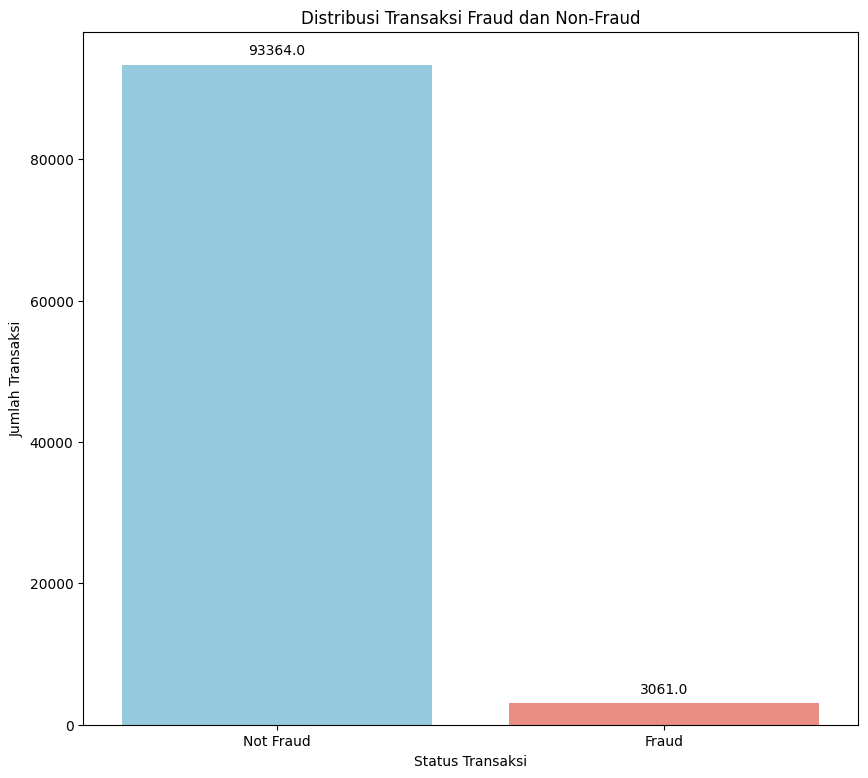

In [39]:
# Visualisasi distribusi fraud dan non-fraud
plt.figure(figsize=(10, 9))
sns.countplot(x='fraud', data=df, palette=['skyblue', 'salmon'])
plt.title('Distribusi Transaksi Fraud dan Non-Fraud')
plt.xlabel('Status Transaksi')
plt.ylabel('Jumlah Transaksi')

# Menambahkan anotasi jumlah pada setiap bar
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                       ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.show()

#### Penanganan Outlier

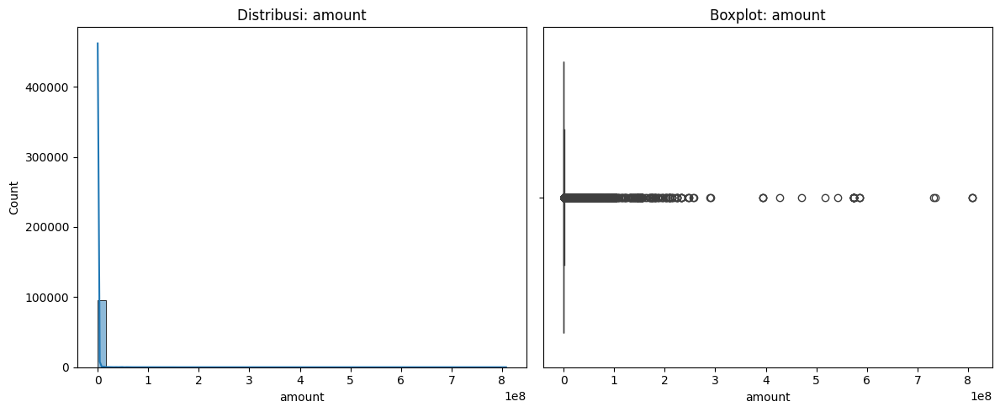

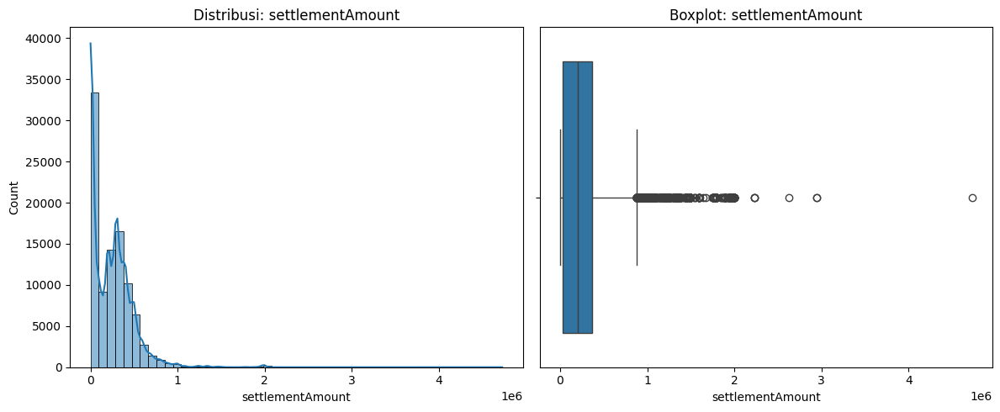

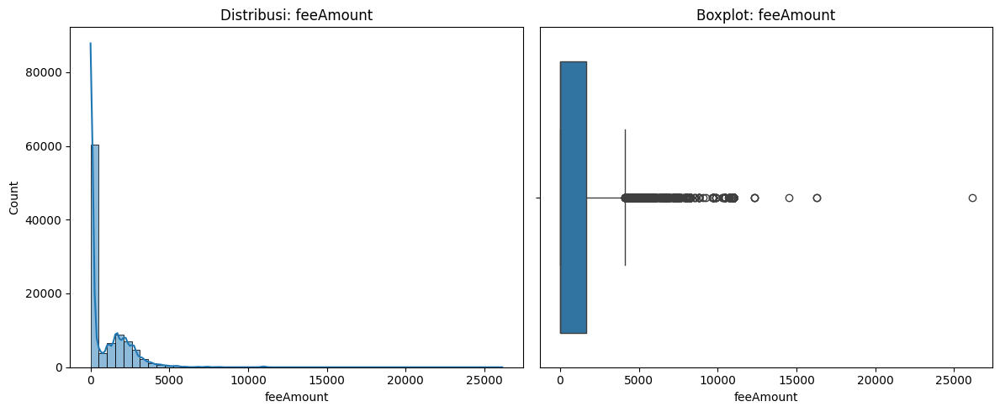

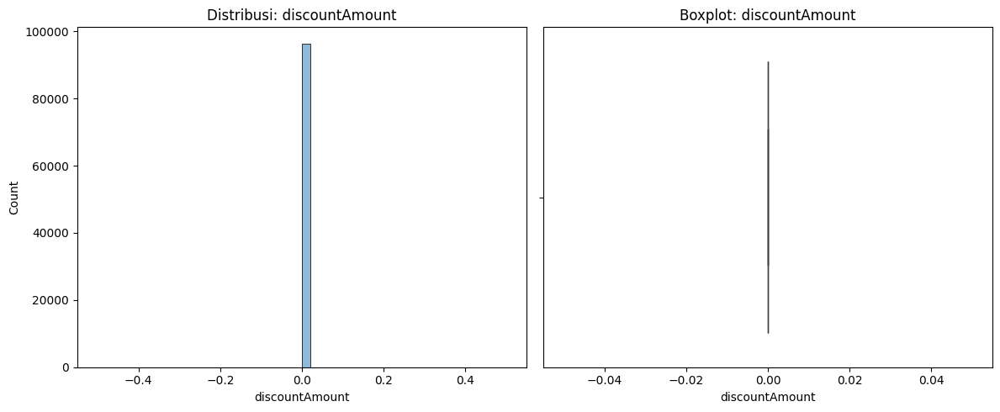

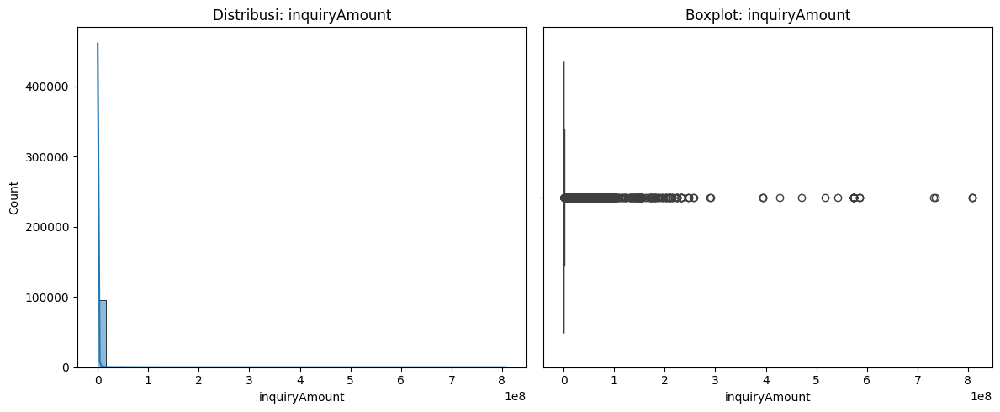

In [40]:
# Ambil kolom numerik
num_cols = ['amount', 'settlementAmount', 'feeAmount', 'discountAmount',
            'inquiryAmount']

# Plot distribusi dan boxplot per fitur numerik
for col in num_cols:
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    sns.histplot(df[col], bins=50, kde=True)
    plt.title(f'Distribusi: {col}')

    plt.subplot(1, 2, 2)
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot: {col}')

    plt.tight_layout()
    plt.show()


In [41]:
# Handling outlier menggunakan IQR
def handle_outliers_iqr(num_cols, column):
    Q1 = num_cols[column].quantile(0.25)
    Q3 = num_cols[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Ganti outlier dengan batas atas/bawah
    num_cols[column] = np.where(num_cols[column] < lower_bound, lower_bound, num_cols[column])
    num_cols[column] = np.where(num_cols[column] > upper_bound, upper_bound, num_cols[column])

    return num_cols

# Ulangi untuk kolom numerik lainnya
for col in num_cols:
    df = handle_outliers_iqr(df, col)

#### Feature Engineering

In [42]:
#Membuat fitur baru
def feature_eng(df):
    df = df.copy()
    epsilon = 1e-6

    # 1. Rasio discount terhadap amount
    df['discount_ratio'] = df['discountAmount'] / (df['amount'] + epsilon)

    # 2. Rasio fee terhadap amount
    df['fee_ratio'] = df['feeAmount'] / (df['amount'] + epsilon)

    # 3. Convert 'createdTime' to datetime before extracting hour
    df['hour_of_day'] = df['createdTime'].dt.hour

    # 4. Selisih waktu proses transaksi
    df['selisih_waktu (sec)'] = (df['updatedTime'] - df['createdTime']).dt.total_seconds()

    return df

df = feature_eng(df)
df

,createdTime,updatedTime,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token,fraud,discount_ratio,fee_ratio,hour_of_day,selisih_waktu (sec)
0,2025-01-01 00:09:17,2025-01-01 00:09:17,IDR,1000.0,merch1,payment,bricard,authenticate,-1,0.0,1000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,0,0.0
1,2025-01-01 00:19:20,2025-01-01 00:19:22,IDR,458250.0,merch1,payment,bricard,captured,00,458250.0,458250.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,0,2.0
2,2025-01-01 00:20:05,2025-01-01 00:20:07,IDR,249000.0,merch1,payment,bricard,captured,00,249000.0,249000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,0,2.0
3,2025-01-01 00:23:43,2025-01-01 00:24:15,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,1000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,0,32.0
4,2025-01-01 00:25:08,2025-01-01 00:25:09,IDR,1000.0,merch1,payment,bricard,declined,01,0.0,1000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96420,2025-02-28 23:40:25,2025-02-28 23:40:28,IDR,300000.0,merch1,payment,bricard,captured,00,300000.0,300000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,23,3.0
96421,2025-02-28 23:43:14,2025-02-28 23:43:17,IDR,350000.0,merch1,payment,bricard,captured,00,350000.0,350000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,23,3.0
96422,2025-02-28 23:47:08,2025-02-28 23:47:10,IDR,25000.0,merch1,payment,bricard,captured,00,25000.0,25000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,23,2.0
96423,2025-02-28 23:51:35,2025-02-28 23:51:57,IDR,0.0,merch1,payment,bricard,authorized,00,0.0,1000.0,0.0,0.0,NaN,Not Fraud,0.0,0.000000,23,22.0


#### Menghitung Korelasi

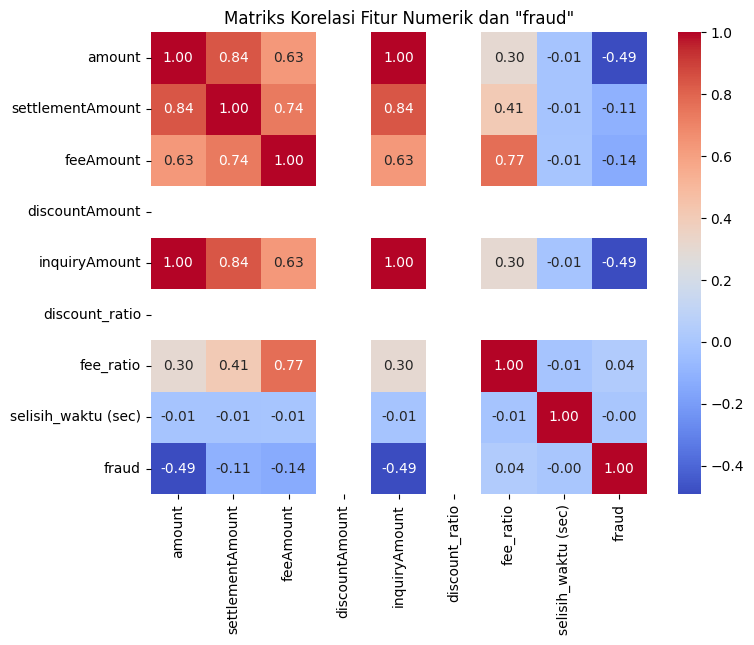

In [43]:
num_cols = ['amount', 'settlementAmount', 'feeAmount', 'discountAmount',
            'inquiryAmount','discount_ratio', 'fee_ratio', 'selisih_waktu (sec)']

#Menghitung Korelasi antar fitur numerik terhadap fraud
le = LabelEncoder()
df['fraud'] = le.fit_transform(df['fraud'].astype(str))

# Calculate correlation matrix for numerical features and 'fraud'
correlation_matrix = df[num_cols + ['fraud']].corr()

# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriks Korelasi Fitur Numerik dan "fraud"')
plt.show()

/tmp/ipython-input-44-962004143.py:7: RuntimeWarning: invalid value encountered in divide
  return np.sqrt(chi2 / (n * (min(k, r) - 1)))
/tmp/ipython-input-44-962004143.py:7: RuntimeWarning: invalid value encountered in divide
  return np.sqrt(chi2 / (n * (min(k, r) - 1)))


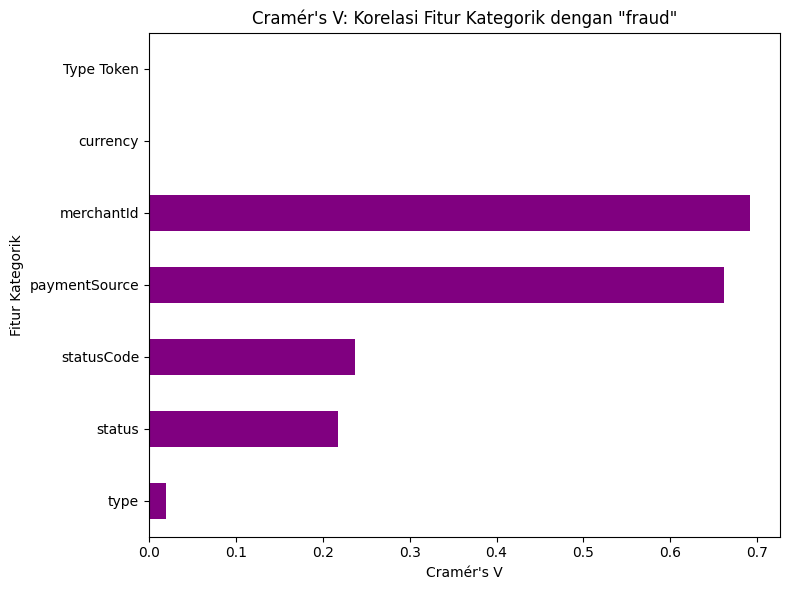

In [44]:
#Menghitung korelasi pada fitur kategorik terhadap fraud
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    r, k = confusion_matrix.shape
    return np.sqrt(chi2 / (n * (min(k, r) - 1)))

# Hitung Cramér's V untuk semua fitur kategorik terhadap 'fraud'
categorical_features = ['merchantId', 'paymentSource', 'status', 'statusCode', 'currency', 'type', 'Type Token']
cramers_results = {}

for col in categorical_features:
    cramers_results[col] = cramers_v(df[col], df['fraud'])

# Visualisasi
cramers_series = pd.Series(cramers_results).sort_values()
plt.figure(figsize=(8, 6))
cramers_series.plot(kind='barh', color='purple')
plt.title('Cramér\'s V: Korelasi Fitur Kategorik dengan "fraud"')
plt.xlabel('Cramér\'s V')
plt.ylabel('Fitur Kategorik')
plt.tight_layout()
plt.show()

#### Feature Transformation

In [45]:
# Inisialisasi kolom
cat_cols = ['merchantId','paymentSource', 'status', 'statusCode', 'currency', 'type', 'Type Token']
num_cols = ['amount', 'settlementAmount', 'feeAmount', 'discountAmount',
            'inquiryAmount','discount_ratio', 'fee_ratio', 'selisih_waktu (sec)']

# Buat fitur waktu
df['hour_sin'] = np.sin(2 * np.pi * df['hour_of_day'] / 24)
df['hour_cos'] = np.cos(2 * np.pi * df['hour_of_day'] / 24)

# Tambahkan ke numerik
num_cols += ['hour_sin', 'hour_cos']

# Buang kolom yang tidak dibutuhkan lagi
df.drop(columns=['hour_of_day', 'createdTime', 'updatedTime'], inplace=True)

#### Feature Labelling

In [46]:
# Label encoding untuk kolom kategorik
le_dict = {}
for col in cat_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col].astype(str))
    le_dict[col] = le

#### Normalisasi

In [47]:
# Normalisasi fitur numerik
scaler = MinMaxScaler()
df[num_cols] = scaler.fit_transform(df[num_cols])

In [48]:
df

,currency,amount,merchantId,type,paymentSource,status,statusCode,settlementAmount,inquiryAmount,discountAmount,feeAmount,Type Token,fraud,discount_ratio,fee_ratio,selisih_waktu (sec),hour_sin,hour_cos
0,0,0.001091,0,0,0,0,0,0.000000,0.001090,0.0,0.000000,0,1,0.0,0.000000,0.000000e+00,0.50000,1.000000
1,0,0.499864,0,0,0,2,1,0.523619,0.499863,0.0,0.000000,0,1,0.0,0.000000,7.510566e-07,0.50000,1.000000
2,0,0.271612,0,0,0,2,1,0.284519,0.271611,0.0,0.000000,0,1,0.0,0.000000,7.510566e-07,0.50000,1.000000
3,0,0.000000,0,0,0,1,1,0.000000,0.001090,0.0,0.000000,0,1,0.0,0.000000,1.201691e-05,0.50000,1.000000
4,0,0.001091,0,0,0,3,2,0.000000,0.001090,0.0,0.000000,0,1,0.0,0.000000,3.755283e-07,0.50000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96420,0,0.327243,0,0,0,2,1,0.342794,0.327242,0.0,0.000000,0,1,0.0,0.000000,1.126585e-06,0.37059,0.982963
96421,0,0.381783,0,0,0,2,1,0.399927,0.381783,0.0,0.000000,0,1,0.0,0.000000,1.126585e-06,0.37059,0.982963
96422,0,0.027270,0,0,0,2,1,0.028566,0.027269,0.0,0.000000,0,1,0.0,0.000000,7.510566e-07,0.37059,0.982963
96423,0,0.000000,0,0,0,1,1,0.000000,0.001090,0.0,0.000000,0,1,0.0,0.000000,8.261623e-06,0.37059,0.982963


#### Mutual Information

In [49]:
# Pisahkan fitur dan label
X = df.drop('fraud', axis=1)
y = df['fraud']

# Hitung MI
mi_scores = mutual_info_classif(X, y, random_state=42)

# Masukkan ke DataFrame biar rapi
mi_df = pd.DataFrame({'Feature': X.columns, 'MI Score': mi_scores})
mi_df = mi_df.sort_values(by='MI Score', ascending=False)

# Tampilkan top fitur
print(mi_df)

                Feature  MI Score
1                amount  0.124130
8         inquiryAmount  0.123508
2            merchantId  0.074250
7      settlementAmount  0.069218
13            fee_ratio  0.060806
4         paymentSource  0.055886
10            feeAmount  0.044981
5                status  0.023548
6            statusCode  0.017525
14  selisih_waktu (sec)  0.011560
15             hour_sin  0.002475
16             hour_cos  0.001917
11           Type Token  0.000797
9        discountAmount  0.000501
3                  type  0.000393
12       discount_ratio  0.000084
0              currency  0.000000


#### Feature Selection

In [50]:
# Drop the specified columns
columns_to_drop = ['currency', 'discountAmount', 'Type Token', 'paymentSource', 'hour_cos',
                   'selisih_waktu (sec)', 'hour_sin', 'type', 'discount_ratio', 'statusCode', 'status']
df = df.drop(columns=columns_to_drop, errors='ignore')

# Display the updated dataframe
df.head()

,amount,merchantId,settlementAmount,inquiryAmount,feeAmount,fraud,fee_ratio
0,0.001091,0,0.000000,0.001090,0.0,1,0.0
1,0.499864,0,0.523619,0.499863,0.0,1,0.0
2,0.271612,0,0.284519,0.271611,0.0,1,0.0
3,0.000000,0,0.000000,0.001090,0.0,1,0.0
4,0.001091,0,0.000000,0.001090,0.0,1,0.0


#### Splitting Data

In [51]:
X = df.drop('fraud', axis=1)
y = df['fraud']

In [52]:
# Split train-test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

In [53]:
X_train

,amount,merchantId,settlementAmount,inquiryAmount,feeAmount,fee_ratio
59985,0.942612,11,0.981978,0.942612,1.000000,0.867915
7113,0.218162,0,0.228530,0.218161,0.000000,0.000000
47265,1.000000,11,0.000000,1.000000,0.000000,0.000000
54943,0.000000,0,0.000000,0.001090,0.000000,0.000000
86999,0.437338,11,0.455602,0.437338,0.534545,0.999948
...,...,...,...,...,...,...
38313,0.234524,0,0.245669,0.234523,0.000000,0.000000
53955,0.001091,0,0.000000,0.001090,0.000000,0.000000
50462,0.655336,11,0.682704,0.655335,0.800970,0.999914
18950,0.434688,11,0.452842,0.434687,0.531152,0.999658


In [54]:
y_train

,fraud
59985,0
7113,1
47265,0
54943,1
86999,1
...,...
38313,1
53955,1
50462,1
18950,1


# Modelling

## Fungsi ELM

In [55]:
# Parameter hidden layer
input_dim = X_train.shape[1]
hidden_neurons = 100

#Fungsi aktivasi
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

#Fungsi training ELM
def train_elm(X_train, y_train, hidden_neurons, activation=sigmoid, seed=42):
    np.random.seed(seed)
    input_dim = X_train.shape[1]
    W = np.random.randn(input_dim, hidden_neurons)
    b = np.random.randn(hidden_neurons)

    H = activation(np.dot(X_train, W) + b)
    H_pinv = np.linalg.pinv(H)
    beta = np.dot(H_pinv, y_train)

    return W, b, beta

#Fungsi prediksi ELM
def predict_elm(X_test, W, b, beta, activation=sigmoid):
    H_test = activation(np.dot(X_test, W) + b)
    y_pred_raw = np.dot(H_test, beta)
    y_pred = (y_pred_raw >= 0.5).astype(int)
    return y_pred

### Data Imbalance

Accuracy Training (ELM): 0.9991184858698471
Accuracy Testing (ELM): 0.9990666320974851

Classification Report (ELM):
               precision    recall  f1-score   support

           0       1.00      0.97      0.99       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       1.00      0.99      0.99     19285
weighted avg       1.00      1.00      1.00     19285



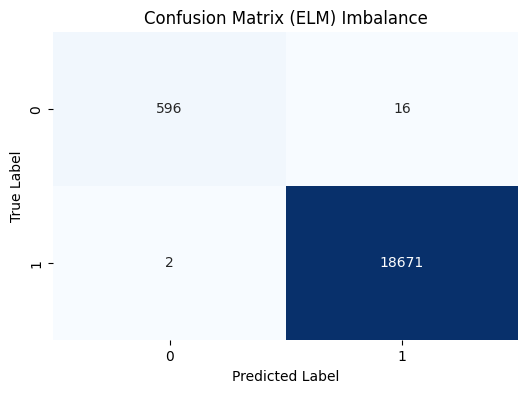

In [56]:
#Inisialisasi model ELM
np.random.seed(42)
W, b, beta = train_elm(X_train, y_train, hidden_neurons)
y_pred = predict_elm(X_test, W, b, beta)

# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_train, predict_elm(X_train, W, b, beta)))
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred))

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Imbalance')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### Oversampling

#### SMOTE

In [57]:
# Inisialisasi dan fit SMOTE
smote = SMOTE(random_state=42)
X_resampled1, y_resampled1 = smote.fit_resample(X_train, y_train)

# Cek distribusi setelah di-resample
print("Distribusi label sebelum SMOTE:", Counter(y_train))
print("Distribusi label setelah SMOTE :", Counter(y_resampled1))

# Gabungkan kembali jadi DataFrame kalau perlu
df_balanced1 = pd.concat([pd.DataFrame(X_resampled1, columns=X_train.columns),
                         pd.DataFrame(y_resampled1, columns=['fraud'])], axis=1)

Distribusi label sebelum SMOTE: Counter({1: 74691, 0: 2449})
Distribusi label setelah SMOTE : Counter({0: 74691, 1: 74691})


Accuracy Training (ELM): 0.9972486644977306
Accuracy Testing (ELM): 0.9958516982110448

Classification Report (ELM):
               precision    recall  f1-score   support

           0       0.89      1.00      0.94       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       0.94      1.00      0.97     19285
weighted avg       1.00      1.00      1.00     19285



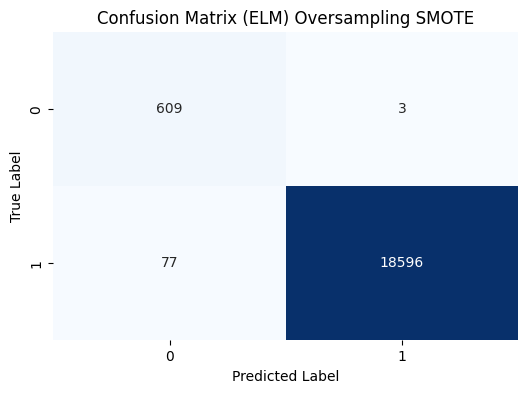

In [58]:
# Latih model pada data yang sudah di-resample
np.random.seed(42)
W1, b1, beta1 = train_elm(X_resampled1, y_resampled1, hidden_neurons)
y_pred1 = predict_elm(X_test, W1, b1, beta1)


# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_resampled1, predict_elm(X_resampled1, W1, b1, beta1))) # Corrected evaluation
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred1))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred1)) # Corrected report title

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred1)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Oversampling SMOTE')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

#### ADASYN

In [59]:
# Inisialisasi dan fit ADASYN
adasyn = ADASYN(random_state=42)
X_resampled2, y_resampled2 = adasyn.fit_resample(X_train, y_train)

# Cek distribusi setelah di-resample
print("Distribusi label sebelum ADASYN:", Counter(y_train))
print("Distribusi label setelah ADASYN :", Counter(y_resampled2))

# Gabungkan kembali jadi DataFrame kalau perlu
df_balanced2 = pd.concat([pd.DataFrame(X_resampled2, columns=X_train.columns),
                         pd.DataFrame(y_resampled2, columns=['fraud'])], axis=1)

Distribusi label sebelum ADASYN: Counter({1: 74691, 0: 2449})
Distribusi label setelah ADASYN : Counter({1: 74691, 0: 74688})


Accuracy Training (ELM): 0.9970009171302526
Accuracy Testing (ELM): 0.9953331604874255

Classification Report (ELM):
               precision    recall  f1-score   support

           0       0.87      1.00      0.93       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       0.94      1.00      0.96     19285
weighted avg       1.00      1.00      1.00     19285



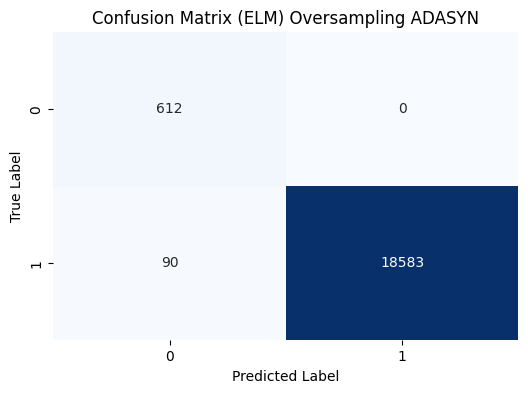

In [60]:
#Inisialisasi model ELM
np.random.seed(42)
W2, b2, beta2 = train_elm(X_resampled2, y_resampled2, hidden_neurons)
y_pred2 = predict_elm(X_test, W2, b2, beta2)

# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_resampled2, predict_elm(X_resampled2, W2, b2, beta2)))
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred2))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred2))

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred2)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Oversampling ADASYN')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### Undersampling

#### Tomek Links

In [61]:
# Inisialisasi dan fit TomekLinks
tl = TomekLinks()
X_resampled3, y_resampled3 = tl.fit_resample(X_train, y_train)

# Cek distribusi setelah di-resample
print("Distribusi label sebelum TomekLinks:", Counter(y_train))
print("Distribusi label setelah TomekLinks :", Counter(y_resampled3))

# Gabungkan kembali jadi DataFrame kalau perlu
df_balanced3 = pd.concat([pd.DataFrame(X_resampled3, columns=X_train.columns),
                         pd.DataFrame(y_resampled3, columns=['fraud'])], axis=1)

Distribusi label sebelum TomekLinks: Counter({1: 74691, 0: 2449})
Distribusi label setelah TomekLinks : Counter({1: 74686, 0: 2449})


Accuracy Training (ELM): 0.999118428728852
Accuracy Testing (ELM): 0.9990666320974851

Classification Report (ELM):
               precision    recall  f1-score   support

           0       1.00      0.97      0.99       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       1.00      0.99      0.99     19285
weighted avg       1.00      1.00      1.00     19285



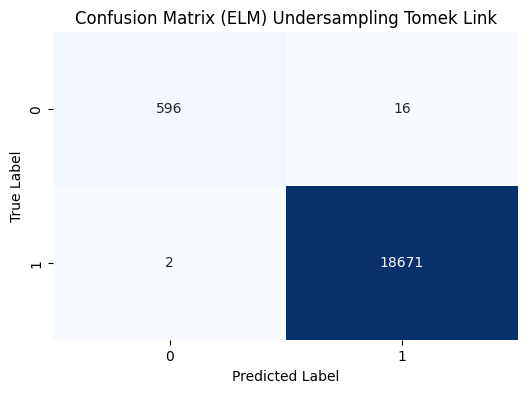

In [62]:
# Latih model pada data yang sudah di-resample
np.random.seed(42)
W3, b3, beta3 = train_elm(X_resampled3, y_resampled3, hidden_neurons)
y_pred3 = predict_elm(X_test, W3, b3, beta3)


# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_resampled3, predict_elm(X_resampled3, W, b, beta))) # Corrected evaluation
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred3))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred3)) # Corrected report title

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred3)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Undersampling Tomek Link')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

#### Edited Nearest Neighbour (ENN)

In [63]:
# Inisialisasi dan fit SMOTE
enn = EditedNearestNeighbours()
X_resampled4, y_resampled4 = enn.fit_resample(X_train, y_train)

# Cek distribusi setelah di-resample
print("Distribusi label sebelum ENN:", Counter(y_train))
print("Distribusi label setelah ENN :", Counter(y_resampled4))

# Gabungkan kembali jadi DataFrame kalau perlu
df_balanced4 = pd.concat([pd.DataFrame(X_resampled4, columns=X_train.columns),
                         pd.DataFrame(y_resampled4, columns=['fraud'])], axis=1)

Distribusi label sebelum ENN: Counter({1: 74691, 0: 2449})
Distribusi label setelah ENN : Counter({1: 74610, 0: 2449})


Accuracy Training (ELM): 0.9993771006631282
Accuracy Testing (ELM): 0.9988073632356754

Classification Report (ELM):
               precision    recall  f1-score   support

           0       0.99      0.98      0.98       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       0.99      0.99      0.99     19285
weighted avg       1.00      1.00      1.00     19285



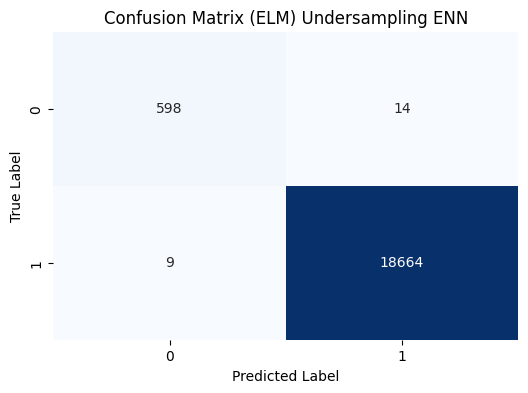

In [64]:
# Latih model pada data yang sudah di-resample
np.random.seed(42)
W4, b4, beta4 = train_elm(X_resampled4, y_resampled4, hidden_neurons)
y_pred4 = predict_elm(X_test, W4, b4, beta4)


# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_resampled4, predict_elm(X_resampled4, W4, b4, beta4)))
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred4))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred4))

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred4)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Undersampling ENN')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### Hybrid Resampling

#### SMOTEENN

In [65]:
# Inisialisasi dan fit SMOTE
smote_enn = SMOTEENN(random_state=42)
X_resampled5, y_resampled5 = smote_enn.fit_resample(X_train, y_train)

# Cek distribusi setelah di-resample
print("Distribusi label sebelum SMOTEENN:", Counter(y_train))
print("Distribusi label setelah SMOTEENN :", Counter(y_resampled5))

# Gabungkan kembali jadi DataFrame kalau perlu
df_balanced5 = pd.concat([pd.DataFrame(X_resampled5, columns=X_train.columns),
                         pd.DataFrame(y_resampled5, columns=['fraud'])], axis=1)

Distribusi label sebelum SMOTEENN: Counter({1: 74691, 0: 2449})
Distribusi label setelah SMOTEENN : Counter({1: 74509, 0: 74243})


Accuracy Training (ELM): 0.99871598365064
Accuracy Testing (ELM): 0.996577651024112

Classification Report (ELM):
               precision    recall  f1-score   support

           0       0.91      0.99      0.95       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       0.96      0.99      0.97     19285
weighted avg       1.00      1.00      1.00     19285



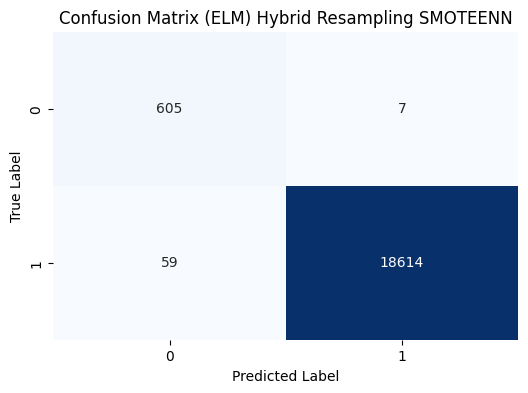

In [66]:
# Latih model pada data yang sudah di-resample
np.random.seed(42)
W5, b5, beta5 = train_elm(X_resampled5, y_resampled5, hidden_neurons)
y_pred5 = predict_elm(X_test, W5, b5, beta5)


# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_resampled5, predict_elm(X_resampled5, W5, b5, beta5)))
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred5))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred5))

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred5)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Hybrid Resampling SMOTEENN')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

#### SMOTETomek

In [67]:
# Inisialisasi dan fit SMOTE
smote_tomek = SMOTETomek(random_state=42)
X_resampled6, y_resampled6 = smote_tomek.fit_resample(X_train, y_train)

# Cek distribusi setelah di-resample
print("Distribusi label sebelum SMOTETomek:", Counter(y_train))
print("Distribusi label setelah SMOTETomek:", Counter(y_resampled6))

# Gabungkan kembali jadi DataFrame kalau perlu
df_balanced6 = pd.concat([pd.DataFrame(X_resampled6, columns=X_train.columns),
                         pd.DataFrame(y_resampled6, columns=['fraud'])], axis=1)

Distribusi label sebelum SMOTETomek: Counter({1: 74691, 0: 2449})
Distribusi label setelah SMOTETomek: Counter({0: 74644, 1: 74644})


Accuracy Training (ELM): 0.9975684582819785
Accuracy Testing (ELM): 0.9958516982110448

Classification Report (ELM):
               precision    recall  f1-score   support

           0       0.89      1.00      0.94       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       0.94      1.00      0.97     19285
weighted avg       1.00      1.00      1.00     19285



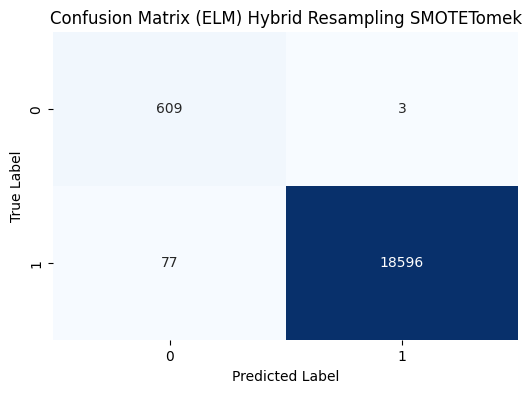

In [68]:
# Latih model pada data yang sudah di-resample
np.random.seed(42)
W6, b6, beta6 = train_elm(X_resampled6, y_resampled6, hidden_neurons)
y_pred6 = predict_elm(X_test, W6, b6, beta6)

# Evaluasi model
print("Accuracy Training (ELM):", accuracy_score(y_resampled6, predict_elm(X_resampled6, W6, b6, beta6)))
print("Accuracy Testing (ELM):", accuracy_score(y_test, y_pred6))
print("\nClassification Report (ELM):\n", classification_report(y_test, y_pred6))

# Confusion Matrix
cm_elm = confusion_matrix(y_test, y_pred1)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_elm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix (ELM) Hybrid Resampling SMOTETomek')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

## Evaluasi

In [69]:
# Mengumpulkan hasil performa dari 3 percobaan
results = {
    'Percobaan': ['Imbalance', 'SMOTE', 'ADASYN', 'Tomeklink','ENN','SMOTEENN', 'SMOTETomek'],
    'Accuracy Training': [accuracy_score(y_train, predict_elm(X_train, W, b, beta)), accuracy_score(y_resampled1, predict_elm(X_resampled1, W1, b1, beta1)),
                          accuracy_score(y_resampled2, predict_elm(X_resampled2, W2, b2, beta2)), accuracy_score(y_resampled3, predict_elm(X_resampled3, W3, b3, beta3)),
                           accuracy_score(y_resampled4, predict_elm(X_resampled4, W4, b4, beta4)), accuracy_score(y_resampled5, predict_elm(X_resampled5, W5, b5, beta5)),
                           accuracy_score(y_resampled6, predict_elm(X_resampled6, W6, b6, beta6))],
    'Accuracy Testing': [accuracy_score(y_test, y_pred), accuracy_score(y_test, y_pred1),
                         accuracy_score(y_test, y_pred2), accuracy_score(y_test, y_pred3),
                         accuracy_score(y_test, y_pred4),accuracy_score(y_test, y_pred5),
                         accuracy_score(y_test, y_pred6)],
    'Precision': [classification_report(y_test, y_pred, output_dict=True)['0']['precision'],
                          classification_report(y_test, y_pred1, output_dict=True)['0']['precision'],
                          classification_report(y_test, y_pred2, output_dict=True)['0']['precision'],
                          classification_report(y_test, y_pred3, output_dict=True)['0']['precision'],
                          classification_report(y_test, y_pred4, output_dict=True)['0']['precision'],
                          classification_report(y_test, y_pred5, output_dict=True)['0']['precision'],
                          classification_report(y_test, y_pred6, output_dict=True)['0']['precision']],
    'Recall': [classification_report(y_test, y_pred, output_dict=True)['0']['recall'],
                       classification_report(y_test, y_pred1, output_dict=True)['0']['recall'],
                       classification_report(y_test, y_pred2, output_dict=True)['0']['recall'],
                       classification_report(y_test, y_pred3, output_dict=True)['0']['recall'],
                       classification_report(y_test, y_pred4, output_dict=True)['0']['recall'],
                       classification_report(y_test, y_pred5, output_dict=True)['0']['recall'],
                       classification_report(y_test, y_pred6, output_dict=True)['0']['recall']],
    'F1-Score': [classification_report(y_test, y_pred, output_dict=True)['0']['f1-score'],
                         classification_report(y_test, y_pred1, output_dict=True)['0']['f1-score'],
                         classification_report(y_test, y_pred2, output_dict=True)['0']['f1-score'],
                         classification_report(y_test, y_pred3, output_dict=True)['0']['f1-score'],
                         classification_report(y_test, y_pred4, output_dict=True)['0']['f1-score'],
                         classification_report(y_test, y_pred5, output_dict=True)['0']['f1-score'],
                         classification_report(y_test, y_pred6, output_dict=True)['0']['f1-score']]
}

# Membuat DataFrame dari hasil
performance_df = pd.DataFrame(results)

# Menampilkan tabel performa
print("\nTabel Performa Percobaan ELM + Teknik Resampling:")
performance_df



Tabel Performa Percobaan ELM + Teknik Resampling:


,Percobaan,Accuracy Training,Accuracy Testing,Precision,Recall,F1-Score
0,Imbalance,0.999118,0.999067,0.996656,0.973856,0.985124
1,SMOTE,0.997249,0.995852,0.887755,0.995098,0.938367
2,ADASYN,0.997001,0.995333,0.871795,1.000000,0.931507
3,Tomeklink,0.999144,0.999067,0.996656,0.973856,0.985124
4,ENN,0.999377,0.998807,0.985173,0.977124,0.981132
5,SMOTEENN,0.998716,0.996578,0.911145,0.988562,0.948276
6,SMOTETomek,0.997568,0.995852,0.887755,0.995098,0.938367


In [71]:
# Mengumpulkan confusion matrices dari 4 percobaan
cm_elm = confusion_matrix(y_test, y_pred)
cm_elm1 = confusion_matrix(y_test, y_pred1)
cm_elm2 = confusion_matrix(y_test, y_pred2)
cm_elm3 = confusion_matrix(y_test, y_pred3)
cm_elm4 = confusion_matrix(y_test, y_pred4)
cm_elm5 = confusion_matrix(y_test, y_pred5)
cm_elm6 = confusion_matrix(y_test, y_pred6)

cm_data = {
    'Percobaan': ['Imbalance', 'SMOTE', 'ADASYN', 'Tomeklink','ENN','SMOTEENN', 'SMOTETomek'],
    'True Negative (TN)': [cm_elm[0, 0], cm_elm1[0, 0], cm_elm2[0, 0], cm_elm3[0, 0], cm_elm4[0, 0], cm_elm5[0, 0], cm_elm6[0, 0]],
    'False Positive (FP)': [cm_elm[0, 1], cm_elm1[0, 1], cm_elm2[0, 1], cm_elm3[0, 1], cm_elm4[0, 1],cm_elm5[0, 1], cm_elm6[0, 1]],
    'False Negative (FN)': [cm_elm[1, 0], cm_elm1[1, 0], cm_elm2[1, 0], cm_elm3[1, 0], cm_elm4[1, 0], cm_elm5[1, 0], cm_elm6[1, 0]],
    'True Positive (TP)': [cm_elm[1, 1], cm_elm1[1, 1], cm_elm2[1, 1], cm_elm3[1, 1], cm_elm4[1, 1], cm_elm5[1, 1], cm_elm6[1, 1]]
}


cm_summary_df = pd.DataFrame(cm_data)

print("\nRingkasan Confusion Matrices Eksperimen ELM + Teknik Resampling:")
cm_summary_df


Ringkasan Confusion Matrices Eksperimen ELM + Teknik Resampling:


,Percobaan,True Negative (TN),False Positive (FP),False Negative (FN),True Positive (TP)
0,Imbalance,596,16,2,18671
1,SMOTE,609,3,77,18596
2,ADASYN,612,0,90,18583
3,Tomeklink,596,16,2,18671
4,ENN,598,14,9,18664
5,SMOTEENN,605,7,59,18614
6,SMOTETomek,609,3,77,18596


metode resampling terbaik adalah ENN. karena nilai dari precision dan recall selisihnya tidak terlalu jauh. dan nilai dari false positive dan false negative hampir seimbang


### Optimalisasi

In [72]:
# Fungsi aktivasi
def activation_function(x, func_type='sigmoid'):
    if func_type == 'sigmoid':
        return 1 / (1 + np.exp(-x))
    elif func_type == 'tanh':
        return np.tanh(x)
    elif func_type == 'relu':
        return np.maximum(0, x)
    else:
        return x

# Fungsi training ELM
def elm_train(X_resampled4, y_resampled4, hidden_neurons, activation):
    input_weights = np.random.randn(X_resampled4.shape[1], hidden_neurons)
    biases = np.random.randn(hidden_neurons)
    H = activation_function(np.dot(X_resampled4, input_weights) + biases, func_type=activation)
    output_weights = np.linalg.pinv(H).dot(y_resampled4)
    return input_weights, biases, output_weights

# Fungsi prediksi ELM
def elm_predict(X, input_weights, biases, output_weights, activation):
    H = activation_function(np.dot(X, input_weights) + biases, func_type=activation)
    y_pred = np.dot(H, output_weights)
    return y_pred

# Fungsi objektif untuk Optuna
def objective(trial):
    activation = trial.suggest_categorical('activation', ['sigmoid', 'tanh', 'relu'])
    hidden_neurons = trial.suggest_int('hidden_neurons', 10, 200)
    threshold = trial.suggest_float('threshold', 0.1, 0.8, step=0.1)

    # Train
    W7, b7, beta7 = elm_train(X_resampled4, y_resampled4, hidden_neurons=hidden_neurons, activation=activation)

    # Predict
    y_pred_raw = elm_predict(X_test, W7, b7, beta7, activation=activation)
    y_pred7 = (y_pred_raw >= threshold).astype(int)

    # Evaluasi
    value = accuracy_score(y_test, y_pred)  # Atau pakai metric lain (misal: f1_score)

    # 🔽 Save model jika lebih baik dari sebelumnya
    if trial.number == 0 or value > trial.study.best_value:
        best_model = {
            'input_weights': W7,
            'biases': b7,
            'output_weights': beta7,
            'activation_type': activation,
            'threshold': threshold
        }
        with open("hyperparameter_ELM.pkl", "wb") as f:
            pickle.dump(best_model, f)
        print(f"✅ Model trial-{trial.number} disimpan dengan skor: {value:.4f}")

    return value  # Atau bisa pakai f1_score, precision, recall

# Jalankan Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)  # Bisa disesuaikan jumlah trial-nya

# Output hasil terbaik
print("Best trial:")
trial = study.best_trial
print(f"  Activation     : {trial.params['activation']}")
print(f"  Hidden Neurons : {trial.params['hidden_neurons']}")
print(f"  Threshold      : {trial.params['threshold']}")
print(f"  Accuracy       : {trial.value}")

[I 2025-07-13 14:28:29,095] A new study created in memory with name: no-name-d7b159f2-6848-47bc-bc12-92188ac63c78
[I 2025-07-13 14:28:30,520] Trial 0 finished with value: 0.9990666320974851 and parameters: {'activation': 'relu', 'hidden_neurons': 112, 'threshold': 0.1}. Best is trial 0 with value: 0.9990666320974851.
[I 2025-07-13 14:28:30,654] Trial 1 finished with value: 0.9990666320974851 and parameters: {'activation': 'relu', 'hidden_neurons': 26, 'threshold': 0.6}. Best is trial 0 with value: 0.9990666320974851.


✅ Model trial-0 disimpan dengan skor: 0.9991


[I 2025-07-13 14:28:31,746] Trial 2 finished with value: 0.9990666320974851 and parameters: {'activation': 'tanh', 'hidden_neurons': 94, 'threshold': 0.4}. Best is trial 0 with value: 0.9990666320974851.
[I 2025-07-13 14:28:34,695] Trial 3 finished with value: 0.9990666320974851 and parameters: {'activation': 'relu', 'hidden_neurons': 185, 'threshold': 0.30000000000000004}. Best is trial 0 with value: 0.9990666320974851.
[I 2025-07-13 14:28:38,676] Trial 4 finished with value: 0.9990666320974851 and parameters: {'activation': 'relu', 'hidden_neurons': 119, 'threshold': 0.6}. Best is trial 0 with value: 0.9990666320974851.
[I 2025-07-13 14:28:40,234] Trial 5 finished with value: 0.9990666320974851 and parameters: {'activation': 'relu', 'hidden_neurons': 71, 'threshold': 0.6}. Best is trial 0 with value: 0.9990666320974851.
[I 2025-07-13 14:28:43,674] Trial 6 finished with value: 0.9990666320974851 and parameters: {'activation': 'sigmoid', 'hidden_neurons': 169, 'threshold': 0.1}. Best i

Best trial:
  Activation     : relu
  Hidden Neurons : 112
  Threshold      : 0.1
  Accuracy       : 0.9990666320974851


Evaluasi setelah Optimalisasi

In [73]:
# Load model yang sudah disimpan dengan pickle
with open("hyperparameter_ELM.pkl", "rb") as f:
    best_model = pickle.load(f)

# Ambil bobot-bobot yang sudah disimpan
W_best = best_model['input_weights']
b_best = best_model['biases']
beta_best = best_model['output_weights']
activation_type = best_model['activation_type']
threshold = best_model['threshold']

# Prediksi pada data testing menggunakan bobot terbaik yang sudah disimpan
H_test = activation_function(np.dot(X_test, W_best) + b_best, func_type=activation_type)
y_pred_raw = np.dot(H_test, beta_best)
y_pred = (y_pred_raw >= threshold).astype(int)

# Evaluasi hasil
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

print("\nClassification Report:")
print(classification_report(y_test, y_pred))


Confusion Matrix:
[[  520    92]
 [    1 18672]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.85      0.92       612
           1       1.00      1.00      1.00     18673

    accuracy                           1.00     19285
   macro avg       1.00      0.92      0.96     19285
weighted avg       1.00      1.00      0.99     19285



# Explainable Artificial Intelligence

In [74]:
# Ambil bobot dari model tersimpan
input_weights = best_model['input_weights']
biases = best_model['biases']
output_weights = best_model['output_weights']
activation_type = best_model['activation_type']
threshold = best_model['threshold']

# Definisikan fungsi aktivasi
def activation_function(x, func_type='sigmoid'):
    if func_type == 'sigmoid':
        return 1 / (1 + np.exp(-x))
    elif func_type == 'tanh':
        return np.tanh(x)
    elif func_type == 'relu':
        return np.maximum(0, x)
    else:
        return x

# Fungsi prediksi probabilitas yang bisa dipanggil LIME
def elm_predict_proba(X):
    # Pastikan X dalam bentuk array
    if isinstance(X, pd.DataFrame):
        X = X.values
    H = activation_function(np.dot(X, input_weights) + biases, func_type=activation_type)
    logits = np.dot(H, output_weights)
    probs = 1 / (1 + np.exp(-logits))  # Sigmoid untuk konversi ke probabilitas
    return np.column_stack([1 - probs, probs])


In [75]:
# Convert X_train to a NumPy array
X_resampled_np = X_resampled4.values

# Setup LIME explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_resampled_np,  # Data latih
    mode="classification",  # Tipe masalah (klasifikasi)
    training_labels=y_resampled4,  # Label data latih
    feature_names=X_resampled4.columns,  # Nama-nama fitur
    class_names=[0, 1],  # Kelas yang mungkin (misalnya 0 dan 1 untuk klasifikasi biner)
    discretize_continuous=True
)

# Pilih instance yang akan dijelaskan (misalnya data uji ke-5)
i = 42
exp = explainer.explain_instance(
    X_test.iloc[i].values,    # Pastikan bentuk array
    elm_predict_proba,
    num_features=5
)

# Tampilkan hasil penjelasan
exp.show_in_notebook(show_table=True, show_all=False)

In [76]:
import random

# Tentukan jumlah instance yang ingin ditampilkan
num_instances = 10

# Pilih 10 index acak dari data test
# Get the valid indexes for X_test
valid_indexes = X_test.index.tolist()
random_indexes = random.sample(valid_indexes, min(num_instances, len(valid_indexes)))

# Tampilkan penjelasan untuk setiap instance yang dipilih
for idx in random_indexes:
    print(f"Menjelaskan instance ke-{idx}")

    # Ambil data untuk instance tertentu
    instance_data = X_test.loc[[idx]]  # Use .loc with double brackets for indexing

    # Buat explainernya
    exp = explainer.explain_instance(
        data_row=instance_data.values[0],  # Pass the NumPy array
        predict_fn=elm_predict_proba,
        num_features=5
    )

    # Tampilkan visualisasi hasil
    exp.show_in_notebook(show_table=True)

Menjelaskan instance ke-568


Menjelaskan instance ke-70998


Menjelaskan instance ke-11569


Menjelaskan instance ke-61540


Menjelaskan instance ke-63685


Menjelaskan instance ke-8899


Menjelaskan instance ke-68399


Menjelaskan instance ke-61638


Menjelaskan instance ke-94568


Menjelaskan instance ke-63662


In [77]:
!pip freeze > requirements.txt